# MARK 10.4


In [ ]:
from google.colab import drive
drive.mount('/gdrive')

In [ ]:
%cd /gdrive/My Drive/ANN/MARK10/

In [ ]:
# NEW TRAINING max(100%,2000)
%cp ./dataset.zip / 
%cd /
!unzip dataset.zip

dataset_dir = 'dataset'

In [ ]:
%cd /gdrive/My Drive/ANN/MARK10/

In [ ]:
# NEW VALIDATION SET since the previous one has only few images not classified
%cp ./new_validation.zip /
%cd /
!rm -r new_validation/
!rm -r __MACOSX/
!unzip new_validation.zip

In [ ]:
import tensorflow as tf
import numpy as np
import os
import random
import pandas as pd
import seaborn as sns
import matplotlib as mpl
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score, f1_score, precision_score, recall_score
from sklearn.metrics import confusion_matrix
from PIL import Image
from keras.regularizers import l2

tfk = tf.keras
tfkl = tf.keras.layers
print(tf.__version__)

2.7.0


In [ ]:
# Random seed for reproducibility
seed = 57

random.seed(seed)
os.environ['PYTHONHASHSEED'] = str(seed)
np.random.seed(seed)
tf.random.set_seed(seed)
tf.compat.v1.set_random_seed(seed)

#Dati
input_shape = (256, 256, 3)
epochs = 200

In [ ]:
dataset_dir = 'dataset'
training_dir = os.path.join(dataset_dir, 'training')

# validation_dir = os.path.join(dataset_dir, 'validation')
validation_dir = os.path.join('/', 'new_validation')

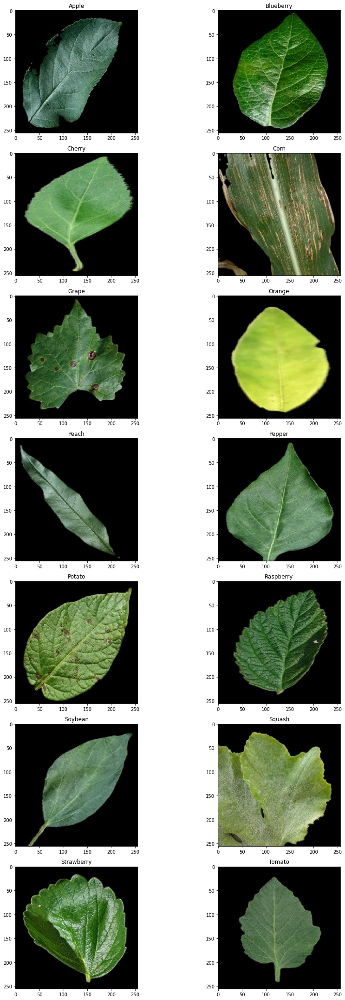

In [ ]:
# Plot example images from dataset
labels = ['Apple','Blueberry','Cherry','Corn','Grape','Orange','Peach','Pepper','Potato','Raspberry','Soybean','Squash','Strawberry','Tomato']

num_row = len(labels)//2
num_col = len(labels)//num_row
fig, axes = plt.subplots(num_row, num_col, figsize=(2*num_row,15*num_col))
for i in range(len(labels)):
  if i < len(labels):
    class_imgs = next(os.walk('{}/{}/'.format(training_dir, labels[i])))[2]
    class_img = class_imgs[0]
    img = Image.open('{}/{}/{}'.format(training_dir, labels[i], class_img))
    ax = axes[i//num_col, i%num_col]
    ax.imshow(np.array(img))
    ax.set_title('{}'.format(labels[i]))
plt.tight_layout()
plt.show()

## Data Augmentation

In [ ]:
pip install Augmentor

In [ ]:
import Augmentor

p = Augmentor.Pipeline()
p.random_distortion(0.1, 20, 20, 2)
p.zoom(probability=0.2, min_factor=0.8, max_factor=1.2)
p.crop_random(0.2,0.5,False)
p.resize(1, 256, 256)
p.skew(0.1, 1)
p.rotate(probability=0.2, max_left_rotation=25, max_right_rotation=25)
argumentor_preprocess_function = p.keras_preprocess_func()

In [ ]:
%cd /
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.applications.efficientnet import preprocess_input
from random import randint
import cv2
from scipy.ndimage.interpolation import map_coordinates
from scipy.ndimage.filters import gaussian_filter


def add_noise(img):
    VARIABILITY = randint(10,40)
    deviation = VARIABILITY*random.random()
    noise = np.random.normal(0, deviation, img.shape)
    img += noise
    np.clip(img, 0., 255.)
    return img

def preprocessIt(image):
  if random.random() < 0.1:
    image = add_noise(image)
    # image = drawRandomLine(image)
  image = argumentor_preprocess_function(image/255.)
  image = preprocess_input(image)
  return image

valid_data_gen = ImageDataGenerator(
                          preprocessing_function=preprocess_input)

aug_train_data_gen =  ImageDataGenerator(#rotation_range=45,
                          # height_shift_range=20,
                          # width_shift_range=20,
                          # zoom_range=0.4,
                          horizontal_flip=True,
                          vertical_flip=True,
                          # fill_mode='wrap',
                          preprocessing_function=preprocessIt
                          )

# Obtain a data generator with the 'ImageDataGenerator.flow_from_directory' method
aug_train_gen =  aug_train_data_gen.flow_from_directory(directory=training_dir,
                                                    target_size=(256,256),
                                                    color_mode = 'rgb',
                                                    class_mode='categorical',
                                                    batch_size = 16,
                                                    shuffle = True,
                                                    seed = seed)

valid_gen = valid_data_gen.flow_from_directory(directory=validation_dir,
                                                    target_size=(256,256),
                                                    color_mode = 'rgb',
                                                    class_mode='categorical',
                                                    batch_size = 16,
                                                    shuffle = False,
                                                    seed = seed)

/
Found 14035 images belonging to 14 classes.
Found 4100 images belonging to 14 classes.


In [ ]:
def get_next_batch(generator):
  batch = next(generator)

  image = batch[0]
  target = batch[1]

  print("(Input) image shape:", image.shape)
  print("Target shape:",target.shape)

  # Visualize only the first sample
  image = image[0]
  target = target[0]
  target_idx = np.argmax(target)
  print()
  print("Categorical label:", target)
  print("Label:", target_idx)
  print("Class name:", labels[target_idx])
  fig = plt.figure(figsize=(6, 4))
  plt.imshow(np.uint8(image))

  return batch

(Input) image shape: (16, 256, 256, 3)
Target shape: (16, 14)

Categorical label: [0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
Label: 5
Class name: Orange


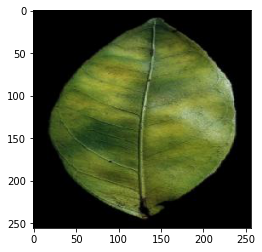

In [ ]:
_ = get_next_batch(aug_train_gen)

## Transfer Learning Setup

In [ ]:
from tensorflow.keras.applications.efficientnet import EfficientNetB7


# Download and plot the EfficientNetB7 model
supernet = tfk.applications.EfficientNetB7(
    include_top=False,
    weights="imagenet",
    input_shape=input_shape
)
supernet.summary()
# tfk.utils.plot_model(supernet)

258088960/258076736 [==============================] - 2s 0us/step
Model: "efficientnetb7"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 256, 256, 3  0           []                               
                                )]                                                                
                                                                                                  
 rescaling (Rescaling)          (None, 256, 256, 3)  0           ['input_1[0][0]']                
                                                                                                  
 normalization (Normalization)  (None, 256, 256, 3)  7           ['rescaling[0][0]']              
                                                                                                  
 stem_conv_pad (Ze

In [ ]:
# Model Building function
def build_model(input_shape):
    supernet.trainable = False
    # Build the neural network layer by layer
    input_layer = tfkl.Input(shape=input_shape, name='Input')
    x = supernet(input_layer)


    
    

    x = tfkl.GlobalAveragePooling2D(name="avg_pool")(x)
    x = tfkl.BatchNormalization()(x)

    x = tfkl.Dropout(0.3, name="top_dropout")(x)

    output_layer = tfkl.Dense(units=14, activation='softmax', kernel_initializer=tfk.initializers.GlorotUniform(seed), name='Output')(x)

    # Connect input and output through the Model class
    model = tfk.Model(inputs=input_layer, outputs=output_layer, name='model')
    optimizer = tf.keras.optimizers.Adam(0.0001)
    
    # Compile the model
    model.compile(loss=tfk.losses.CategoricalCrossentropy(), optimizer=optimizer, metrics='accuracy')

    # Return the model
    return model


In [ ]:
model = build_model(input_shape)
model.summary()

Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 Input (InputLayer)          [(None, 256, 256, 3)]     0         
                                                                 
 efficientnetb7 (Functional)  (None, 8, 8, 2560)       64097687  
                                                                 
 avg_pool (GlobalAveragePool  (None, 2560)             0         
 ing2D)                                                          
                                                                 
 batch_normalization_1 (Batc  (None, 2560)             10240     
 hNormalization)                                                 
                                                                 
 top_dropout (Dropout)       (None, 2560)              0         
                                                                 
 Output (Dense)              (None, 14)                35854 

## Callbacks

In [ ]:
early_stopping = tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=10, restore_best_weights=True)

rlrop = tf.keras.callbacks.ReduceLROnPlateau(monitor='val_loss', mode='min', patience= 4, factor= 0.5, min_lr= 1e-6, verbose=1)

callbacks = []

callbacks.append(rlrop)
callbacks.append(early_stopping)

In [ ]:
%cd /gdrive/My Drive/ANN/MARK10/

/gdrive/My Drive/ANN/MARK10


We had to remove these callbacks since training was too slow and also colab crashed few times during training with these callbacks (Exausted Resources)

Update: saving model in .h5 could make ckpts and best saving feasible during training without loosing too much time (and without using too much memory)

In [ ]:
from datetime import *

exps_dir = os.path.join('ckpts_and_logs')
if not os.path.exists(exps_dir):
  os.makedirs(exps_dir)

now = datetime.now().strftime('%b%d_%H-%M-%S')

exp_dir = os.path.join(exps_dir, 'MARK10' + '_' + str(now))
if not os.path.exists(exp_dir):
  os.makedirs(exp_dir)

  # Model checkpoint
  # ----------------
ckpt_dir = os.path.join(exp_dir, 'ckpts')
if not os.path.exists(ckpt_dir):
  os.makedirs(ckpt_dir)

ckpt_callback = tf.keras.callbacks.ModelCheckpoint(filepath=os.path.join(ckpt_dir, 'cp'),
                                                     save_weights_only=False,
                                                     save_best_only=False)
  
  # Model best
  # ----------------
bst_dir = os.path.join(exp_dir, 'best')
if not os.path.exists(bst_dir):
  os.makedirs(bst_dir)

bst_callback = tf.keras.callbacks.ModelCheckpoint(filepath=os.path.join(bst_dir, 'best'),
                                                     save_weights_only=False,
                                                     save_best_only=True)
tb_dir = os.path.join(exp_dir, 'tb_logs')
if not os.path.exists(tb_dir):
      os.makedirs(tb_dir)
      
tb_callback = tf.keras.callbacks.TensorBoard(log_dir=tb_dir,
                                     profile_batch=0,
                                     histogram_freq=1)


# callbacks.append(tb_callback)
# callbacks.append(ckpt_callback)
# callbacks.append(bst_callback)

In [ ]:
%cd /

/


## Class Weights

In [ ]:
from sklearn.utils import class_weight

# class_weights = class_weight.compute_class_weight('balanced', np.unique(aug_train_gen.labels), aug_train_gen.labels)

class_weights = class_weight.compute_class_weight(
                                        class_weight = "balanced",
                                        classes = np.unique(aug_train_gen.labels),
                                        y = aug_train_gen.labels                                                    
                                    )

print(class_weights)

minimum = 0
minimum = min(class_weights)

cv = {}
for i in range(14):
  cv[i] = class_weights[i]/minimum

print(cv)

[1.01467611 2.14668094 1.71955403 0.83126036 0.68758573 0.57351259
 1.02610031 1.31045752 1.40013966 3.79734848 0.62035891 1.74651568
 1.48959881 0.50125   ]
{0: 2.0242914979757085, 1: 4.282655246252677, 2: 3.430531732418525, 3: 1.658374792703151, 4: 1.3717421124828533, 5: 1.1441647597254005, 6: 2.0470829068577276, 7: 2.6143790849673203, 8: 2.793296089385475, 9: 7.575757575757576, 10: 1.2376237623762376, 11: 3.4843205574912894, 12: 2.971768202080238, 13: 1.0}


In [ ]:
tf.get_logger().setLevel('ERROR')

history = model.fit(
    x = aug_train_gen,
    epochs = epochs,
    validation_data = valid_gen,
    callbacks=callbacks,
    class_weight=cv
).history

Epoch 1/200
878/878 [==============================] - 211s 221ms/step - loss: 2.6977 - accuracy: 0.5998 - val_loss: 0.5619 - val_accuracy: 0.8371 - lr: 1.0000e-04
Epoch 2/200
878/878 [==============================] - 188s 214ms/step - loss: 1.4179 - accuracy: 0.7855 - val_loss: 0.4459 - val_accuracy: 0.8668 - lr: 1.0000e-04
Epoch 3/200
878/878 [==============================] - 190s 216ms/step - loss: 1.0821 - accuracy: 0.8304 - val_loss: 0.4116 - val_accuracy: 0.8715 - lr: 1.0000e-04
Epoch 4/200
878/878 [==============================] - 187s 213ms/step - loss: 0.9835 - accuracy: 0.8424 - val_loss: 0.3846 - val_accuracy: 0.8810 - lr: 1.0000e-04
Epoch 5/200
878/878 [==============================] - 187s 213ms/step - loss: 0.8501 - accuracy: 0.8607 - val_loss: 0.3387 - val_accuracy: 0.8934 - lr: 1.0000e-04
Epoch 6/200
878/878 [==============================] - 187s 212ms/step - loss: 0.8270 - accuracy: 0.8724 - val_loss: 0.3195 - val_accuracy: 0.8995 - lr: 1.0000e-04
Epoch 7/200
878/

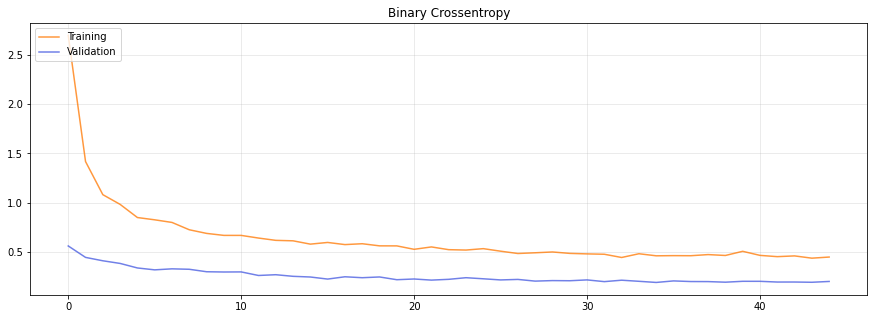

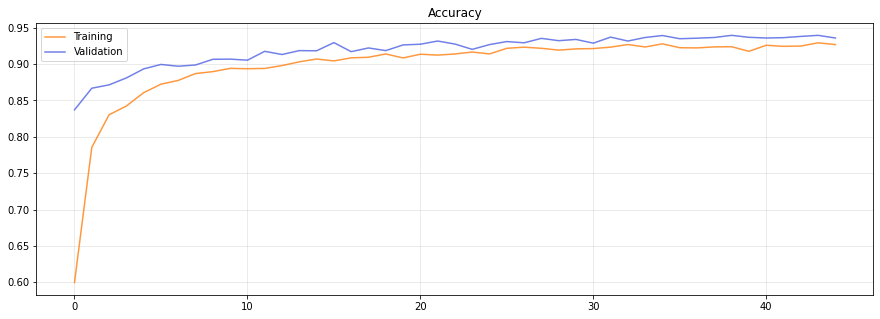

In [ ]:
# Plot the training
plt.figure(figsize=(15,5))
plt.plot(history['loss'], label='Training', alpha=.8, color='#ff7f0e')
plt.plot(history['val_loss'], label='Validation', alpha=.8, color='#4D61E2')
plt.legend(loc='upper left')
plt.title('Binary Crossentropy')
plt.grid(alpha=.3)

plt.figure(figsize=(15,5))
plt.plot(history['accuracy'], label='Training', alpha=.8, color='#ff7f0e')
plt.plot(history['val_accuracy'], label='Validation', alpha=.8, color='#4D61E2')
plt.legend(loc='upper left')
plt.title('Accuracy')
plt.grid(alpha=.3)

plt.show()

In [ ]:
%cd /gdrive/My Drive/ANN/MARK10/

/gdrive/My Drive/ANN/MARK10


In [ ]:
model.save('Model_MARK10_transfer_new.h5')

/usr/local/lib/python3.7/dist-packages/keras/engine/functional.py:1410: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  layer_config = serialize_layer_fn(layer)


# PROGRESSIVE FINE TUNING

## Last two blocks

In [ ]:
%cd /gdrive/My Drive/ANN/MARK10/

/gdrive/My Drive/ANN/MARK10


In [ ]:
model = tf.keras.models.load_model('Model_MARK10_transfer_new.h5')

In [ ]:
import Augmentor

p = Augmentor.Pipeline()
p.rotate(probability=0.2, max_left_rotation=25, max_right_rotation=25)
p.zoom(probability=0.2, min_factor=0.9, max_factor=1.4)
p.random_distortion(0.2, 20, 20, 3)
p.skew(0.2, 1)
p.crop_random(0.2,0.5,False)
p.resize(1, 256, 256)
argumentor_preprocess_function = p.keras_preprocess_func()

In [ ]:
# IMPROVE ARGUMENTATION
%cd /
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.applications.efficientnet import preprocess_input
from random import randint
import cv2
from scipy.ndimage.interpolation import map_coordinates
from scipy.ndimage.filters import gaussian_filter


def add_noise(img):
    VARIABILITY = randint(10,50)
    deviation = VARIABILITY*random.random()
    noise = np.random.normal(0, deviation, img.shape)
    img += noise
    np.clip(img, 0., 255.)
    return img

def preprocessIt(image):
  if random.random() < 0.1:
    image = add_noise(image)
  image = argumentor_preprocess_function(image/255.)
  image = preprocess_input(image)
  return image

valid_data_gen = ImageDataGenerator(
                          preprocessing_function=preprocess_input)

aug_train_data_gen =  ImageDataGenerator(#rotation_range=45,
                          # height_shift_range=20,
                          # width_shift_range=20,
                          # zoom_range=0.4,
                          horizontal_flip=True,
                          vertical_flip=True,
                          brightness_range=[0.5,1.8],
                          preprocessing_function=preprocessIt
                          )

# Obtain a data generator with the 'ImageDataGenerator.flow_from_directory' method
aug_train_gen =  aug_train_data_gen.flow_from_directory(directory=training_dir,
                                                    target_size=(256,256),
                                                    color_mode = 'rgb',
                                                    class_mode='categorical',
                                                    batch_size = 16,
                                                    shuffle = True,
                                                    seed = seed)

valid_gen = valid_data_gen.flow_from_directory(directory=validation_dir,
                                                    target_size=(256,256),
                                                    color_mode = 'rgb',
                                                    class_mode='categorical',
                                                    batch_size = 16,
                                                    shuffle = False,
                                                    seed = seed)

/
Found 14035 images belonging to 14 classes.
Found 4100 images belonging to 14 classes.


(Input) image shape: (16, 256, 256, 3)
Target shape: (16, 14)

Categorical label: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1.]
Label: 13
Class name: Tomato


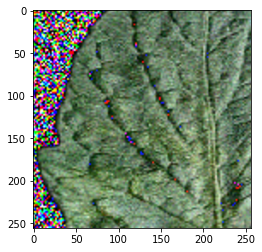

In [ ]:
# Visual inspection :D
_ = get_next_batch(aug_train_gen)

In [ ]:
###


# Set all VGG layers to True
model.get_layer('efficientnetb7').trainable = True
for i, layer in enumerate(model.get_layer('efficientnetb7').layers):
   print(i, layer.name, layer.trainable)

0 input_1 True
1 rescaling True
2 normalization True
3 stem_conv_pad True
4 stem_conv True
5 stem_bn True
6 stem_activation True
7 block1a_dwconv True
8 block1a_bn True
9 block1a_activation True
10 block1a_se_squeeze True
11 block1a_se_reshape True
12 block1a_se_reduce True
13 block1a_se_expand True
14 block1a_se_excite True
15 block1a_project_conv True
16 block1a_project_bn True
17 block1b_dwconv True
18 block1b_bn True
19 block1b_activation True
20 block1b_se_squeeze True
21 block1b_se_reshape True
22 block1b_se_reduce True
23 block1b_se_expand True
24 block1b_se_excite True
25 block1b_project_conv True
26 block1b_project_bn True
27 block1b_drop True
28 block1b_add True
29 block1c_dwconv True
30 block1c_bn True
31 block1c_activation True
32 block1c_se_squeeze True
33 block1c_se_reshape True
34 block1c_se_reduce True
35 block1c_se_expand True
36 block1c_se_excite True
37 block1c_project_conv True
38 block1c_project_bn True
39 block1c_drop True
40 block1c_add True
41 block1d_dwconv Tru

In [ ]:
# FINETUNING BLOCKs 6, 7
for i, layer in enumerate(model.get_layer('efficientnetb7').layers[:556]):
  layer.trainable=False
for i, layer in enumerate(model.get_layer('efficientnetb7').layers):
   print(i, layer.name, layer.trainable)
model.summary()

0 input_1 False
1 rescaling False
2 normalization False
3 stem_conv_pad False
4 stem_conv False
5 stem_bn False
6 stem_activation False
7 block1a_dwconv False
8 block1a_bn False
9 block1a_activation False
10 block1a_se_squeeze False
11 block1a_se_reshape False
12 block1a_se_reduce False
13 block1a_se_expand False
14 block1a_se_excite False
15 block1a_project_conv False
16 block1a_project_bn False
17 block1b_dwconv False
18 block1b_bn False
19 block1b_activation False
20 block1b_se_squeeze False
21 block1b_se_reshape False
22 block1b_se_reduce False
23 block1b_se_expand False
24 block1b_se_excite False
25 block1b_project_conv False
26 block1b_project_bn False
27 block1b_drop False
28 block1b_add False
29 block1c_dwconv False
30 block1c_bn False
31 block1c_activation False
32 block1c_se_squeeze False
33 block1c_se_reshape False
34 block1c_se_reduce False
35 block1c_se_expand False
36 block1c_se_excite False
37 block1c_project_conv False
38 block1c_project_bn False
39 block1c_drop False
4

In [ ]:
early_stopping = tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=10, restore_best_weights=True)

rlrop = tf.keras.callbacks.ReduceLROnPlateau(monitor='val_loss', mode='min', patience= 3, factor= 0.5, min_lr= 1e-8, verbose=1)

callbacks = []

callbacks.append(rlrop)
callbacks.append(early_stopping)

In [ ]:
%cd /

/


In [ ]:
# Compile the model
model.compile(loss=tfk.losses.CategoricalCrossentropy(), optimizer=tfk.optimizers.Adam(0.00005), metrics='accuracy')
model.summary()

Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 Input (InputLayer)          [(None, 256, 256, 3)]     0         
                                                                 
 efficientnetb7 (Functional)  (None, 8, 8, 2560)       64097687  
                                                                 
 avg_pool (GlobalAveragePool  (None, 2560)             0         
 ing2D)                                                          
                                                                 
 batch_normalization_1 (Batc  (None, 2560)             10240     
 hNormalization)                                                 
                                                                 
 top_dropout (Dropout)       (None, 2560)              0         
                                                                 
 Output (Dense)              (None, 14)                35854 

In [ ]:
# Fine-tune the model
tf.get_logger().setLevel('ERROR')
ft_history = model.fit(
     x = aug_train_gen,
    epochs = epochs,
    validation_data = valid_gen,
    callbacks=callbacks,
    class_weight=cv
).history

Epoch 1/200
878/878 [==============================] - 295s 304ms/step - loss: 1.0245 - accuracy: 0.8491 - val_loss: 0.1891 - val_accuracy: 0.9402 - lr: 5.0000e-05
Epoch 2/200
878/878 [==============================] - 264s 301ms/step - loss: 0.5079 - accuracy: 0.9171 - val_loss: 0.1019 - val_accuracy: 0.9688 - lr: 5.0000e-05
Epoch 3/200
878/878 [==============================] - 265s 302ms/step - loss: 0.4159 - accuracy: 0.9335 - val_loss: 0.0630 - val_accuracy: 0.9807 - lr: 5.0000e-05
Epoch 4/200
878/878 [==============================] - 265s 302ms/step - loss: 0.3691 - accuracy: 0.9409 - val_loss: 0.0506 - val_accuracy: 0.9837 - lr: 5.0000e-05
Epoch 5/200
878/878 [==============================] - 264s 301ms/step - loss: 0.3218 - accuracy: 0.9486 - val_loss: 0.0876 - val_accuracy: 0.9759 - lr: 5.0000e-05
Epoch 6/200
878/878 [==============================] - 262s 298ms/step - loss: 0.2854 - accuracy: 0.9550 - val_loss: 0.0406 - val_accuracy: 0.9890 - lr: 5.0000e-05
Epoch 7/200
878/

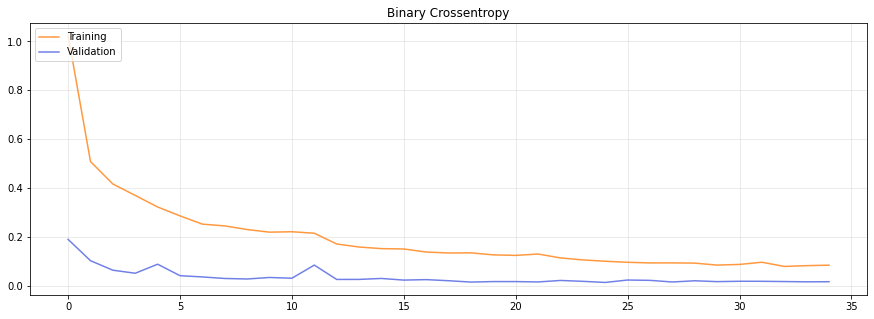

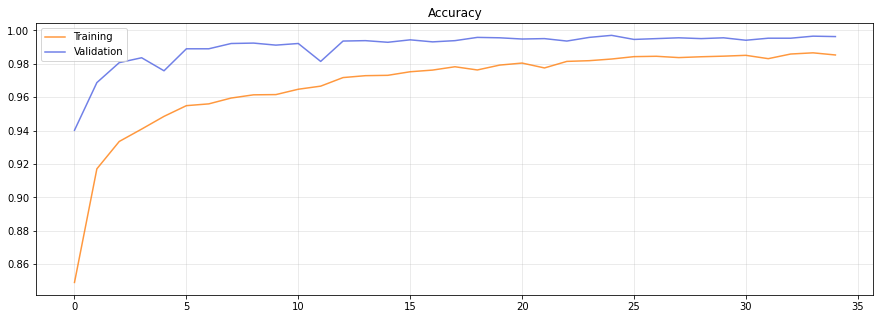

In [ ]:
# Plot the training
plt.figure(figsize=(15,5))
plt.plot(ft_history['loss'], label='Training', alpha=.8, color='#ff7f0e')
plt.plot(ft_history['val_loss'], label='Validation', alpha=.8, color='#4D61E2')
plt.legend(loc='upper left')
plt.title('Binary Crossentropy')
plt.grid(alpha=.3)

plt.figure(figsize=(15,5))
plt.plot(ft_history['accuracy'], label='Training', alpha=.8, color='#ff7f0e')
plt.plot(ft_history['val_accuracy'], label='Validation', alpha=.8, color='#4D61E2')
plt.legend(loc='upper left')
plt.title('Accuracy')
plt.grid(alpha=.3)

plt.show()

In [ ]:
%cd /gdrive/My Drive/ANN/MARK10/

/gdrive/My Drive/ANN/MARK10


In [ ]:
model.save('Model_MARK10_finetuning_1_new.h5')

/usr/local/lib/python3.7/dist-packages/keras/engine/functional.py:1410: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  layer_config = serialize_layer_fn(layer)


## Last four blocks

In [ ]:
%cd /gdrive/My Drive/ANN/MARK10/

/gdrive/My Drive/ANN/MARK10


In [ ]:
model = tf.keras.models.load_model('Model_MARK10_finetuning_1_new.h5')

In [ ]:
import Augmentor

p = Augmentor.Pipeline()
p.rotate(probability=0.2, max_left_rotation=25, max_right_rotation=25)
p.crop_random(0.3,0.6,False)
p.resize(1, 256, 256)
p.zoom(probability=0.3, min_factor=0.6, max_factor=1.2)
p.random_distortion(0.2, 20, 20, 2)
p.skew(0.2, 1)
argumentor_preprocess_function = p.keras_preprocess_func()

In [ ]:
# IMPROVE ARGUMENTATION
%cd /
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.applications.efficientnet import preprocess_input
from random import randint
import cv2
from scipy.ndimage.interpolation import map_coordinates
from scipy.ndimage.filters import gaussian_filter


def add_noise(img):
    VARIABILITY = randint(10,40)
    deviation = VARIABILITY*random.random()
    noise = np.random.normal(0, deviation, img.shape)
    img += noise
    np.clip(img, 0., 255.)
    return img

def preprocessIt(image):
  if random.random() < 0.1:
    image = add_noise(image)
  image = argumentor_preprocess_function(image/255.)
  image = preprocess_input(image)
  return image

valid_data_gen = ImageDataGenerator(
                          preprocessing_function=preprocess_input)

aug_train_data_gen =  ImageDataGenerator(#rotation_range=45,
                          height_shift_range=10,
                          width_shift_range=10,
                          # zoom_range=0.4,
                          horizontal_flip=True,
                          vertical_flip=True,
                          brightness_range=[0.5,1.8],
                          preprocessing_function=preprocessIt
                          )

# Obtain a data generator with the 'ImageDataGenerator.flow_from_directory' method
aug_train_gen =  aug_train_data_gen.flow_from_directory(directory=training_dir,
                                                    target_size=(256,256),
                                                    color_mode = 'rgb',
                                                    class_mode='categorical',
                                                    batch_size = 16,
                                                    shuffle = True,
                                                    seed = seed)

valid_gen = valid_data_gen.flow_from_directory(directory=validation_dir,
                                                    target_size=(256,256),
                                                    color_mode = 'rgb',
                                                    class_mode='categorical',
                                                    batch_size = 16,
                                                    shuffle = False,
                                                    seed = seed)

/
Found 14035 images belonging to 14 classes.
Found 4100 images belonging to 14 classes.


(Input) image shape: (16, 256, 256, 3)
Target shape: (16, 14)

Categorical label: [0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
Label: 5
Class name: Orange


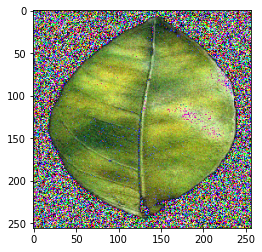

In [ ]:
# Visual inspection :D
_ = get_next_batch(aug_train_gen)

In [ ]:
###


# Set all VGG layers to True
model.get_layer('efficientnetb7').trainable = True
for i, layer in enumerate(model.get_layer('efficientnetb7').layers):
   print(i, layer.name, layer.trainable)

0 input_1 True
1 rescaling True
2 normalization True
3 stem_conv_pad True
4 stem_conv True
5 stem_bn True
6 stem_activation True
7 block1a_dwconv True
8 block1a_bn True
9 block1a_activation True
10 block1a_se_squeeze True
11 block1a_se_reshape True
12 block1a_se_reduce True
13 block1a_se_expand True
14 block1a_se_excite True
15 block1a_project_conv True
16 block1a_project_bn True
17 block1b_dwconv True
18 block1b_bn True
19 block1b_activation True
20 block1b_se_squeeze True
21 block1b_se_reshape True
22 block1b_se_reduce True
23 block1b_se_expand True
24 block1b_se_excite True
25 block1b_project_conv True
26 block1b_project_bn True
27 block1b_drop True
28 block1b_add True
29 block1c_dwconv True
30 block1c_bn True
31 block1c_activation True
32 block1c_se_squeeze True
33 block1c_se_reshape True
34 block1c_se_reduce True
35 block1c_se_expand True
36 block1c_se_excite True
37 block1c_project_conv True
38 block1c_project_bn True
39 block1c_drop True
40 block1c_add True
41 block1d_dwconv Tru

In [ ]:
# FINETUNING BLOCKs 6, 7
for i, layer in enumerate(model.get_layer('efficientnetb7').layers[:259]):
  layer.trainable=False
for i, layer in enumerate(model.get_layer('efficientnetb7').layers):
   print(i, layer.name, layer.trainable)
model.summary()

0 input_1 False
1 rescaling False
2 normalization False
3 stem_conv_pad False
4 stem_conv False
5 stem_bn False
6 stem_activation False
7 block1a_dwconv False
8 block1a_bn False
9 block1a_activation False
10 block1a_se_squeeze False
11 block1a_se_reshape False
12 block1a_se_reduce False
13 block1a_se_expand False
14 block1a_se_excite False
15 block1a_project_conv False
16 block1a_project_bn False
17 block1b_dwconv False
18 block1b_bn False
19 block1b_activation False
20 block1b_se_squeeze False
21 block1b_se_reshape False
22 block1b_se_reduce False
23 block1b_se_expand False
24 block1b_se_excite False
25 block1b_project_conv False
26 block1b_project_bn False
27 block1b_drop False
28 block1b_add False
29 block1c_dwconv False
30 block1c_bn False
31 block1c_activation False
32 block1c_se_squeeze False
33 block1c_se_reshape False
34 block1c_se_reduce False
35 block1c_se_expand False
36 block1c_se_excite False
37 block1c_project_conv False
38 block1c_project_bn False
39 block1c_drop False
4

In [ ]:
early_stopping = tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=6, restore_best_weights=True)

rlrop = tf.keras.callbacks.ReduceLROnPlateau(monitor='val_loss', mode='min', patience= 3, factor= 0.5, min_lr= 1e-8, verbose=1)

callbacks = []

callbacks.append(rlrop)
callbacks.append(early_stopping)

In [ ]:
%cd /

/


In [ ]:
# Compile the model
model.compile(loss=tfk.losses.CategoricalCrossentropy(), optimizer=tfk.optimizers.Adam(0.00001), metrics='accuracy')
model.summary()

Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 Input (InputLayer)          [(None, 256, 256, 3)]     0         
                                                                 
 efficientnetb7 (Functional)  (None, 8, 8, 2560)       64097687  
                                                                 
 avg_pool (GlobalAveragePool  (None, 2560)             0         
 ing2D)                                                          
                                                                 
 batch_normalization_1 (Batc  (None, 2560)             10240     
 hNormalization)                                                 
                                                                 
 top_dropout (Dropout)       (None, 2560)              0         
                                                                 
 Output (Dense)              (None, 14)                35854 

In [ ]:
# Fine-tune the model
tf.get_logger().setLevel('ERROR')
ft_history = model.fit(
     x = aug_train_gen,
    epochs = epochs,
    validation_data = valid_gen,
    callbacks=callbacks,
    class_weight=cv
).history

Epoch 1/200
878/878 [==============================] - 512s 546ms/step - loss: 0.1419 - accuracy: 0.9775 - val_loss: 0.0261 - val_accuracy: 0.9915 - lr: 1.0000e-05
Epoch 2/200
878/878 [==============================] - 476s 541ms/step - loss: 0.1150 - accuracy: 0.9802 - val_loss: 0.0234 - val_accuracy: 0.9917 - lr: 1.0000e-05
Epoch 3/200
878/878 [==============================] - 475s 541ms/step - loss: 0.0994 - accuracy: 0.9828 - val_loss: 0.0198 - val_accuracy: 0.9937 - lr: 1.0000e-05
Epoch 4/200
878/878 [==============================] - 477s 543ms/step - loss: 0.0919 - accuracy: 0.9830 - val_loss: 0.0164 - val_accuracy: 0.9946 - lr: 1.0000e-05
Epoch 5/200
878/878 [==============================] - 476s 542ms/step - loss: 0.0882 - accuracy: 0.9850 - val_loss: 0.0185 - val_accuracy: 0.9941 - lr: 1.0000e-05
Epoch 6/200
878/878 [==============================] - 475s 541ms/step - loss: 0.0716 - accuracy: 0.9865 - val_loss: 0.0183 - val_accuracy: 0.9951 - lr: 1.0000e-05
Epoch 7/200
878/

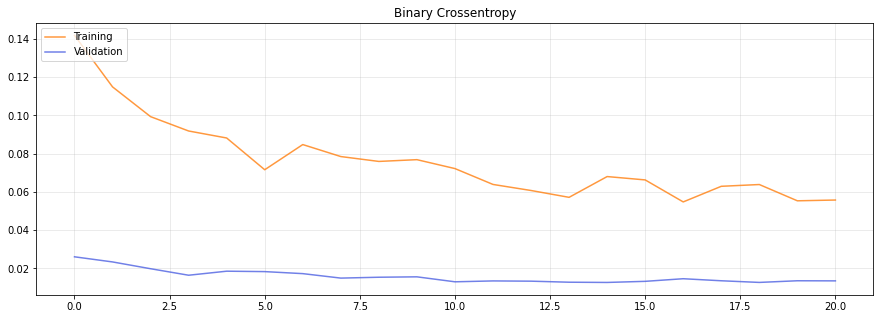

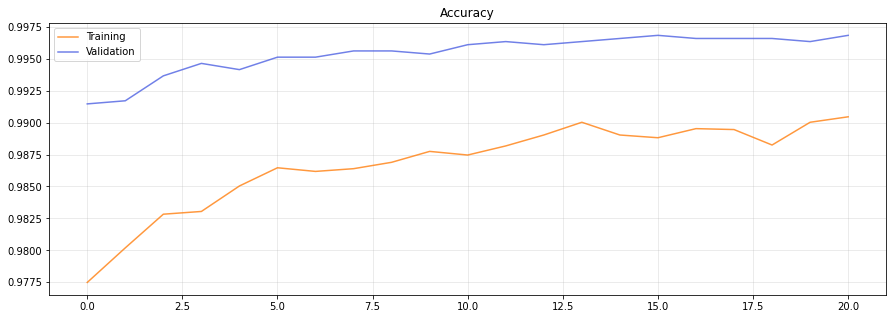

In [ ]:
# Plot the training
plt.figure(figsize=(15,5))
plt.plot(ft_history['loss'], label='Training', alpha=.8, color='#ff7f0e')
plt.plot(ft_history['val_loss'], label='Validation', alpha=.8, color='#4D61E2')
plt.legend(loc='upper left')
plt.title('Binary Crossentropy')
plt.grid(alpha=.3)

plt.figure(figsize=(15,5))
plt.plot(ft_history['accuracy'], label='Training', alpha=.8, color='#ff7f0e')
plt.plot(ft_history['val_accuracy'], label='Validation', alpha=.8, color='#4D61E2')
plt.legend(loc='upper left')
plt.title('Accuracy')
plt.grid(alpha=.3)

plt.show()

In [ ]:
%cd /gdrive/My Drive/ANN/MARK10/

/gdrive/My Drive/ANN/MARK10


In [ ]:
model.save('Model_MARK10_finetuning_2_new.h5')

/usr/local/lib/python3.7/dist-packages/keras/engine/functional.py:1410: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  layer_config = serialize_layer_fn(layer)


## Last six blocks

In [ ]:
%cd /gdrive/My Drive/ANN/MARK10/

/gdrive/My Drive/ANN/MARK10


In [ ]:
model = tf.keras.models.load_model('Model_MARK10_finetuning_2_new.h5')

In [ ]:
import Augmentor

p = Augmentor.Pipeline()
p.rotate(probability=0.2, max_left_rotation=25, max_right_rotation=25)
p.crop_random(0.3,0.6,False)
p.resize(1, 256, 256)
p.zoom(probability=0.3, min_factor=0.6, max_factor=1.2)
p.random_distortion(0.2, 20, 20, 2)
p.skew(0.2, 1)
argumentor_preprocess_function = p.keras_preprocess_func()

In [ ]:
# IMPROVE ARGUMENTATION
%cd /
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.applications.efficientnet import preprocess_input
from random import randint
import cv2
from scipy.ndimage.interpolation import map_coordinates
from scipy.ndimage.filters import gaussian_filter


def add_noise(img):
    VARIABILITY = randint(10,40)
    deviation = VARIABILITY*random.random()
    noise = np.random.normal(0, deviation, img.shape)
    img += noise
    np.clip(img, 0., 255.)
    return img

def preprocessIt(image):
  if random.random() < 0.1:
    image = add_noise(image)
  image = argumentor_preprocess_function(image/255.)
  image = preprocess_input(image)
  return image

valid_data_gen = ImageDataGenerator(
                          preprocessing_function=preprocess_input)

aug_train_data_gen =  ImageDataGenerator(#rotation_range=45,
                          height_shift_range=10,
                          width_shift_range=10,
                          # zoom_range=0.4,
                          horizontal_flip=True,
                          vertical_flip=True,
                          brightness_range=[0.5,1.8],
                          preprocessing_function=preprocessIt
                          )

# Obtain a data generator with the 'ImageDataGenerator.flow_from_directory' method
aug_train_gen =  aug_train_data_gen.flow_from_directory(directory=training_dir,
                                                    target_size=(256,256),
                                                    color_mode = 'rgb',
                                                    class_mode='categorical',
                                                    batch_size = 16,
                                                    shuffle = True,
                                                    seed = seed)

valid_gen = valid_data_gen.flow_from_directory(directory=validation_dir,
                                                    target_size=(256,256),
                                                    color_mode = 'rgb',
                                                    class_mode='categorical',
                                                    batch_size = 16,
                                                    shuffle = False,
                                                    seed = seed)

/
Found 14035 images belonging to 14 classes.
Found 4100 images belonging to 14 classes.


(Input) image shape: (16, 256, 256, 3)
Target shape: (16, 14)

Categorical label: [0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0.]
Label: 7
Class name: Pepper


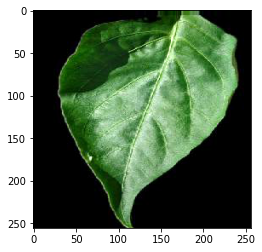

In [ ]:
# Visual inspection :D
_ = get_next_batch(aug_train_gen)

In [ ]:
###


# Set all VGG layers to True
model.get_layer('efficientnetb7').trainable = True
for i, layer in enumerate(model.get_layer('efficientnetb7').layers):
   print(i, layer.name, layer.trainable)

0 input_1 True
1 rescaling True
2 normalization True
3 stem_conv_pad True
4 stem_conv True
5 stem_bn True
6 stem_activation True
7 block1a_dwconv True
8 block1a_bn True
9 block1a_activation True
10 block1a_se_squeeze True
11 block1a_se_reshape True
12 block1a_se_reduce True
13 block1a_se_expand True
14 block1a_se_excite True
15 block1a_project_conv True
16 block1a_project_bn True
17 block1b_dwconv True
18 block1b_bn True
19 block1b_activation True
20 block1b_se_squeeze True
21 block1b_se_reshape True
22 block1b_se_reduce True
23 block1b_se_expand True
24 block1b_se_excite True
25 block1b_project_conv True
26 block1b_project_bn True
27 block1b_drop True
28 block1b_add True
29 block1c_dwconv True
30 block1c_bn True
31 block1c_activation True
32 block1c_se_squeeze True
33 block1c_se_reshape True
34 block1c_se_reduce True
35 block1c_se_expand True
36 block1c_se_excite True
37 block1c_project_conv True
38 block1c_project_bn True
39 block1c_drop True
40 block1c_add True
41 block1d_dwconv Tru

In [ ]:
# FINETUNING BLOCKs 6, 7
for i, layer in enumerate(model.get_layer('efficientnetb7').layers[:51]):
  layer.trainable=False
for i, layer in enumerate(model.get_layer('efficientnetb7').layers):
   print(i, layer.name, layer.trainable)
model.summary()

0 input_1 False
1 rescaling False
2 normalization False
3 stem_conv_pad False
4 stem_conv False
5 stem_bn False
6 stem_activation False
7 block1a_dwconv False
8 block1a_bn False
9 block1a_activation False
10 block1a_se_squeeze False
11 block1a_se_reshape False
12 block1a_se_reduce False
13 block1a_se_expand False
14 block1a_se_excite False
15 block1a_project_conv False
16 block1a_project_bn False
17 block1b_dwconv False
18 block1b_bn False
19 block1b_activation False
20 block1b_se_squeeze False
21 block1b_se_reshape False
22 block1b_se_reduce False
23 block1b_se_expand False
24 block1b_se_excite False
25 block1b_project_conv False
26 block1b_project_bn False
27 block1b_drop False
28 block1b_add False
29 block1c_dwconv False
30 block1c_bn False
31 block1c_activation False
32 block1c_se_squeeze False
33 block1c_se_reshape False
34 block1c_se_reduce False
35 block1c_se_expand False
36 block1c_se_excite False
37 block1c_project_conv False
38 block1c_project_bn False
39 block1c_drop False
4

In [ ]:
early_stopping = tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=8, restore_best_weights=True)

rlrop = tf.keras.callbacks.ReduceLROnPlateau(monitor='val_loss', mode='min', patience= 3, factor= 0.5, min_lr= 1e-8, verbose=1)

callbacks = []

callbacks.append(rlrop)
callbacks.append(early_stopping)

In [ ]:
%cd /

/


In [ ]:
# Compile the model
model.compile(loss=tfk.losses.CategoricalCrossentropy(), optimizer=tfk.optimizers.Adam(0.00001), metrics='accuracy')
model.summary()

Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 Input (InputLayer)          [(None, 256, 256, 3)]     0         
                                                                 
 efficientnetb7 (Functional)  (None, 8, 8, 2560)       64097687  
                                                                 
 avg_pool (GlobalAveragePool  (None, 2560)             0         
 ing2D)                                                          
                                                                 
 batch_normalization_1 (Batc  (None, 2560)             10240     
 hNormalization)                                                 
                                                                 
 top_dropout (Dropout)       (None, 2560)              0         
                                                                 
 Output (Dense)              (None, 14)                35854 

In [ ]:
# Fine-tune the model
tf.get_logger().setLevel('ERROR')
ft_history = model.fit(
     x = aug_train_gen,
    epochs = epochs,
    validation_data = valid_gen,
    callbacks=callbacks,
    class_weight=cv
).history

Epoch 1/200
878/878 [==============================] - 633s 679ms/step - loss: 0.1008 - accuracy: 0.9830 - val_loss: 0.0207 - val_accuracy: 0.9932 - lr: 1.0000e-05
Epoch 2/200
878/878 [==============================] - 590s 671ms/step - loss: 0.0883 - accuracy: 0.9857 - val_loss: 0.0175 - val_accuracy: 0.9949 - lr: 1.0000e-05
Epoch 3/200
878/878 [==============================] - 591s 672ms/step - loss: 0.0831 - accuracy: 0.9848 - val_loss: 0.0204 - val_accuracy: 0.9944 - lr: 1.0000e-05
Epoch 4/200
878/878 [==============================] - 591s 672ms/step - loss: 0.0678 - accuracy: 0.9891 - val_loss: 0.0204 - val_accuracy: 0.9937 - lr: 1.0000e-05
Epoch 5/200
878/878 [==============================] - 591s 673ms/step - loss: 0.0754 - accuracy: 0.9872 - val_loss: 0.0159 - val_accuracy: 0.9954 - lr: 1.0000e-05
Epoch 6/200
878/878 [==============================] - 590s 672ms/step - loss: 0.0645 - accuracy: 0.9885 - val_loss: 0.0179 - val_accuracy: 0.9944 - lr: 1.0000e-05
Epoch 7/200
878/

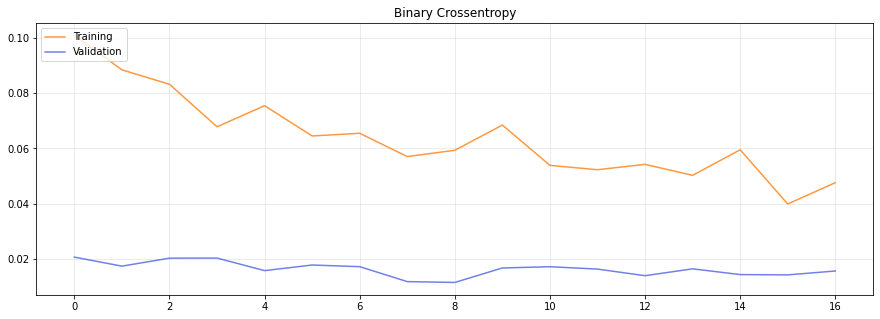

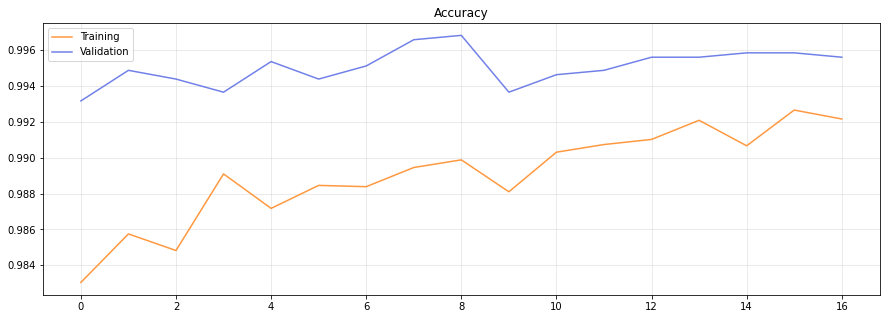

In [ ]:
# Plot the training
plt.figure(figsize=(15,5))
plt.plot(ft_history['loss'], label='Training', alpha=.8, color='#ff7f0e')
plt.plot(ft_history['val_loss'], label='Validation', alpha=.8, color='#4D61E2')
plt.legend(loc='upper left')
plt.title('Binary Crossentropy')
plt.grid(alpha=.3)

plt.figure(figsize=(15,5))
plt.plot(ft_history['accuracy'], label='Training', alpha=.8, color='#ff7f0e')
plt.plot(ft_history['val_accuracy'], label='Validation', alpha=.8, color='#4D61E2')
plt.legend(loc='upper left')
plt.title('Accuracy')
plt.grid(alpha=.3)

plt.show()

In [ ]:
%cd /gdrive/My Drive/ANN/MARK10/

/gdrive/My Drive/ANN/MARK10


In [ ]:
model.save('Model_MARK10_finetuning_3_new.h5')

/usr/local/lib/python3.7/dist-packages/keras/engine/functional.py:1410: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  layer_config = serialize_layer_fn(layer)


# TEST

## First Test

In [ ]:
%cd /gdrive/My Drive/ANN/MARK10/

/gdrive/My Drive/ANN/MARK10


In [ ]:
model = tf.keras.models.load_model('Model_MARK10_finetuning_1_new.h5')

In [ ]:
%cd /gdrive/My Drive/ANN/MARK10/

/gdrive/My Drive/ANN/MARK10


In [ ]:
%cp ./test_final.zip / 
%cd /
!unzip test_final.zip

test_dir = os.path.join('/', 'test_final')

Output streaming troncato alle ultime 5000 righe.
  inflating: test_final/Tomato/24831.JPG  
  inflating: __MACOSX/test_final/Tomato/._24831.JPG  
  inflating: test_final/Tomato/26940.JPG  
  inflating: __MACOSX/test_final/Tomato/._26940.JPG  
  inflating: test_final/Tomato/12830.JPG  
  inflating: __MACOSX/test_final/Tomato/._12830.JPG  
  inflating: test_final/Tomato/28574.JPG  
  inflating: __MACOSX/test_final/Tomato/._28574.JPG  
  inflating: test_final/Tomato/19781.JPG  
  inflating: __MACOSX/test_final/Tomato/._19781.JPG  
  inflating: test_final/Tomato/22065.JPG  
  inflating: __MACOSX/test_final/Tomato/._22065.JPG  
  inflating: test_final/Tomato/10835.JPG  
  inflating: __MACOSX/test_final/Tomato/._10835.JPG  
  inflating: test_final/Tomato/10821.JPG  
  inflating: __MACOSX/test_final/Tomato/._10821.JPG  
  inflating: test_final/Tomato/16288.JPG  
  inflating: __MACOSX/test_final/Tomato/._16288.JPG  
  inflating: test_final/Tomato/23569.JPG  
  inflating: __MACOSX/test_final/T

In [ ]:
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.applications.efficientnet import preprocess_input

test_data_generator = ImageDataGenerator(
    preprocessing_function=preprocess_input)




test_gen = test_data_generator.flow_from_directory(

    directory=test_dir, # the directory

    target_size=(256,256), # the size I want for the images (it resize the images to that one) - we use the original one

    color_mode='rgb', # use the tree channels for the colors

    classes=None, # default is None (this allows to decide from the name of the classes which is the integer to be associated to this class)

                  #   with None, it will read the folder name, and order it in lexicographical order

                  #   classes=lables    ## will give the integer associated to the classes as lable!

    batch_size=14,

    shuffle=False, # to shuffle the data at the end of every epoch 

    seed=57

)

Found 14000 images belonging to 14 classes.


In [ ]:
model_noaug_test_metrics = model.evaluate(test_gen, return_dict=True)

print()

print("Test metrics without data augmentation")

print(model_noaug_test_metrics)

1000/1000 [==============================] - 152s 141ms/step - loss: 0.0122 - accuracy: 0.9959

Test metrics without data augmentation
{'loss': 0.012188433669507504, 'accuracy': 0.9958571195602417}


In [ ]:
from sklearn.metrics import classification_report, confusion_matrix

Y_pred = model.predict(test_gen, 14000)

y_pred = np.argmax(Y_pred, axis=1)

print('Confusion Matrix')

cm = confusion_matrix(test_gen.classes, y_pred)

print(cm)

print('Classification Report')

labels = ['Apple','Blueberry','Cherry','Corn','Grape','Orange','Peach','Pepper','Potato','Raspberry','Soybean','Squash','Strawberry','Tomato']

print(classification_report(test_gen.classes, y_pred, target_names=labels))

Confusion Matrix
[[ 987    0    8    0    1    0    0    2    0    0    0    0    1    1]
 [   0  999    0    0    0    0    0    0    0    0    0    0    1    0]
 [   0    0  998    1    0    0    0    1    0    0    0    0    0    0]
 [   0    0    0  998    0    0    2    0    0    0    0    0    0    0]
 [   0    0    0    0  997    0    0    0    0    0    2    1    0    0]
 [   0    2    0    0    0  994    0    4    0    0    0    0    0    0]
 [   5    0    2    2    0    0  986    1    0    0    1    0    0    3]
 [   0    0    0    0    0    0    0 1000    0    0    0    0    0    0]
 [   1    1    0    0    0    0    1    2  990    0    2    0    0    3]
 [   0    0    0    0    0    0    0    0    0 1000    0    0    0    0]
 [   0    0    1    0    0    0    0    0    0    0  997    0    0    2]
 [   0    0    0    0    0    0    0    0    0    0    0 1000    0    0]
 [   0    0    1    0    0    0    0    0    0    0    0    0  998    1]
 [   0    0    0    0    0    0   

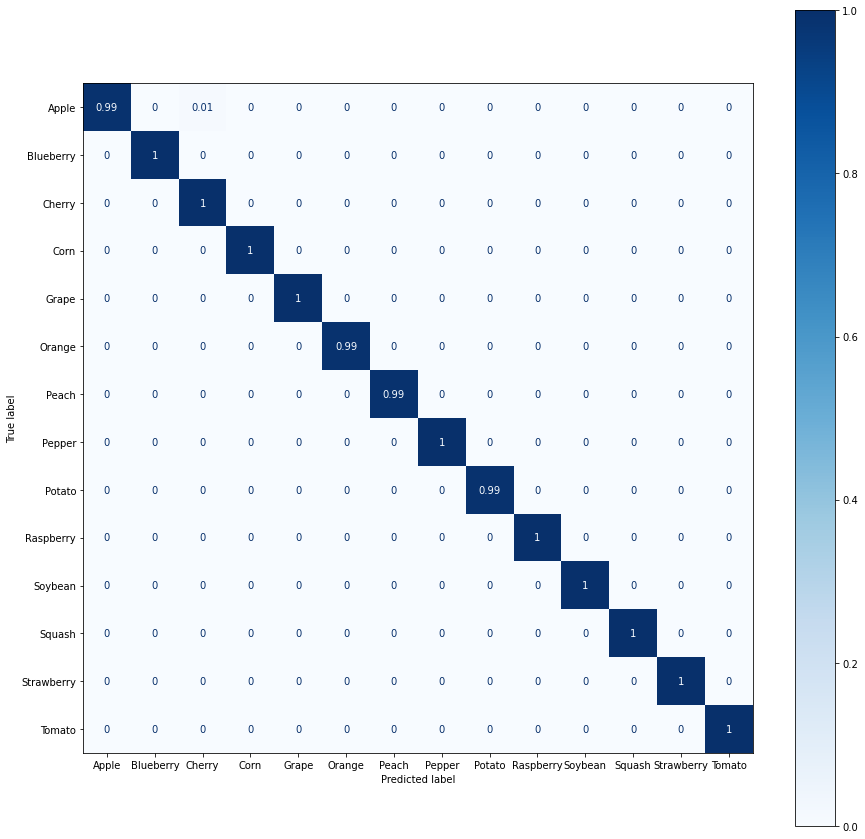

In [ ]:
from sklearn.metrics import ConfusionMatrixDisplay



cm1 = np.zeros(shape=(14,14))

for i in range(14):
  sum = np.sum(cm[i])
  for j in range(14):
    cm1[i][j] = round(cm[i][j]/sum,2)


disp = ConfusionMatrixDisplay(confusion_matrix=cm1, display_labels=labels)

fig, ax = plt.subplots(figsize=(15, 15))
disp.plot(cmap=plt.cm.Blues, ax=ax)
plt.show()

## Second Test

In [ ]:
%cd /gdrive/My Drive/ANN/MARK10/

/gdrive/My Drive/ANN/MARK10


In [ ]:
model = tf.keras.models.load_model('Model_MARK10_finetuning_2_new.h5')

In [ ]:
model_noaug_test_metrics = model.evaluate(test_gen, return_dict=True)

print()

print("Test metrics without data augmentation")

print(model_noaug_test_metrics)

1000/1000 [==============================] - 145s 141ms/step - loss: 0.0136 - accuracy: 0.9966

Test metrics without data augmentation
{'loss': 0.013581459410488605, 'accuracy': 0.99657142162323}


In [ ]:
from sklearn.metrics import classification_report, confusion_matrix

Y_pred = model.predict(test_gen, 14000)

y_pred = np.argmax(Y_pred, axis=1)

print('Confusion Matrix')

cm = confusion_matrix(test_gen.classes, y_pred)

print(cm)

print('Classification Report')

print(classification_report(test_gen.classes, y_pred, target_names=labels))

Confusion Matrix
[[ 989    0    6    0    1    0    2    0    0    0    0    2    0    0]
 [   0  994    0    0    0    0    0    0    0    0    0    0    6    0]
 [   0    0  997    1    0    0    0    0    1    1    0    0    0    0]
 [   0    0    0 1000    0    0    0    0    0    0    0    0    0    0]
 [   0    0    0    0  998    0    0    0    0    0    1    1    0    0]
 [   0    1    0    1    0  996    1    0    0    0    0    1    0    0]
 [   3    0    0    0    0    0  997    0    0    0    0    0    0    0]
 [   0    0    0    0    0    0    0 1000    0    0    0    0    0    0]
 [   0    1    1    0    0    0    0    0  994    1    1    0    0    2]
 [   0    0    0    0    0    0    0    0    0 1000    0    0    0    0]
 [   1    0    0    0    0    0    0    0    0    0  999    0    0    0]
 [   0    0    0    0    0    0    0    0    0    0    0 1000    0    0]
 [   0    0    0    1    0    0    0    0    0    0    0    0  999    0]
 [   0    0    0    0    0    0   

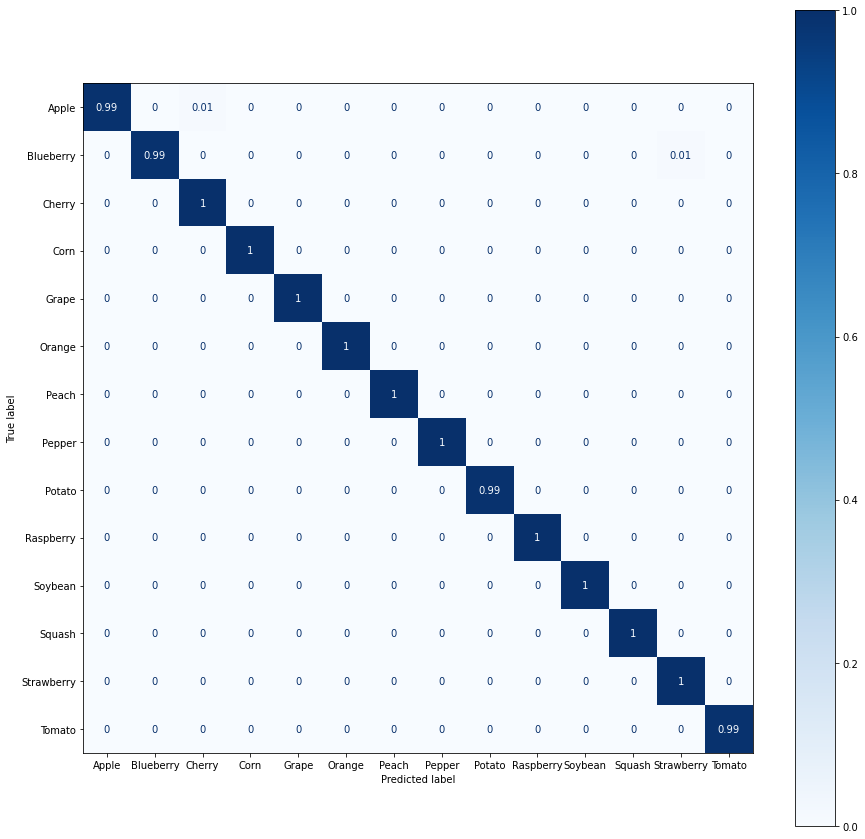

In [ ]:
from sklearn.metrics import ConfusionMatrixDisplay



cm1 = np.zeros(shape=(14,14))

for i in range(14):
  sum = np.sum(cm[i])
  for j in range(14):
    cm1[i][j] = round(cm[i][j]/sum,2)


disp = ConfusionMatrixDisplay(confusion_matrix=cm1, display_labels=labels)

fig, ax = plt.subplots(figsize=(15, 15))
disp.plot(cmap=plt.cm.Blues, ax=ax)
plt.show()

## Last Test

In [ ]:
%cd /gdrive/My Drive/ANN/MARK10/

/gdrive/My Drive/ANN/MARK10


In [ ]:
model = tf.keras.models.load_model('Model_MARK10_finetuning_3_new.h5')

In [ ]:
model_noaug_test_metrics = model.evaluate(test_gen, return_dict=True)

print()

print("Test metrics without data augmentation")

print(model_noaug_test_metrics)

1000/1000 [==============================] - 145s 142ms/step - loss: 0.0090 - accuracy: 0.9978

Test metrics without data augmentation
{'loss': 0.008953675627708435, 'accuracy': 0.9977856874465942}


In [ ]:
from sklearn.metrics import classification_report, confusion_matrix

Y_pred = model.predict(test_gen, 14000)

y_pred = np.argmax(Y_pred, axis=1)

print('Confusion Matrix')

cm = confusion_matrix(test_gen.classes, y_pred)

print(cm)

print('Classification Report')

print(classification_report(test_gen.classes, y_pred, target_names=labels))

Confusion Matrix
[[ 996    0    0    0    2    0    0    0    0    0    0    2    0    0]
 [   0  993    0    0    0    0    0    0    2    0    1    0    4    0]
 [   0    0  998    1    0    0    0    0    1    0    0    0    0    0]
 [   0    0    0 1000    0    0    0    0    0    0    0    0    0    0]
 [   0    0    0    0  999    0    0    0    0    0    1    0    0    0]
 [   0    1    0    0    0  998    1    0    0    0    0    0    0    0]
 [   0    0    0    0    0    0 1000    0    0    0    0    0    0    0]
 [   0    0    0    1    0    0    0  998    0    0    0    0    0    1]
 [   3    0    0    0    0    0    0    0  996    0    0    0    0    1]
 [   0    0    0    0    0    0    0    0    0 1000    0    0    0    0]
 [   0    0    0    0    0    0    0    0    0    0 1000    0    0    0]
 [   0    0    0    0    0    0    0    0    0    0    0 1000    0    0]
 [   0    0    0    1    0    0    0    0    0    0    0    0  999    0]
 [   0    0    0    0    1    0   

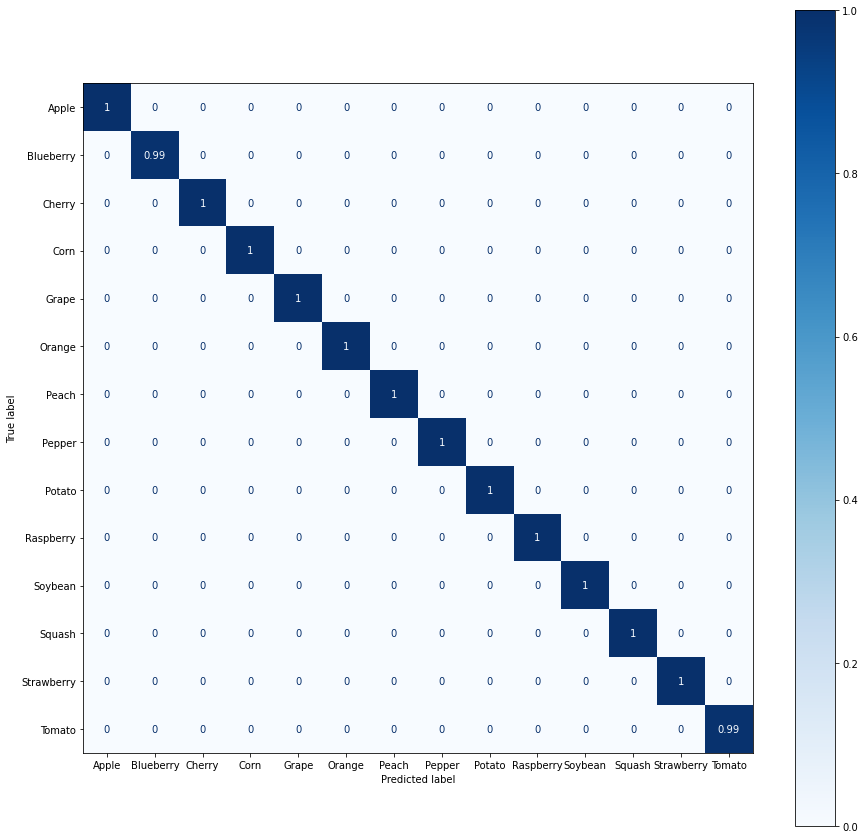

In [ ]:
from sklearn.metrics import ConfusionMatrixDisplay



cm1 = np.zeros(shape=(14,14))

for i in range(14):
  sum = np.sum(cm[i])
  for j in range(14):
    cm1[i][j] = round(cm[i][j]/sum,2)


disp = ConfusionMatrixDisplay(confusion_matrix=cm1, display_labels=labels)

fig, ax = plt.subplots(figsize=(15, 15))
disp.plot(cmap=plt.cm.Blues, ax=ax)
plt.show()

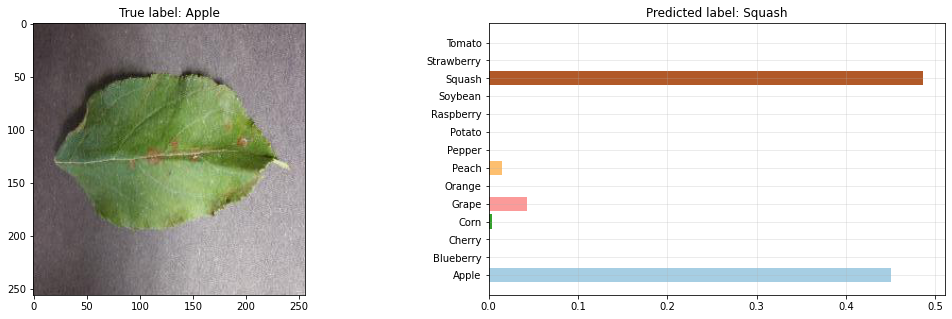

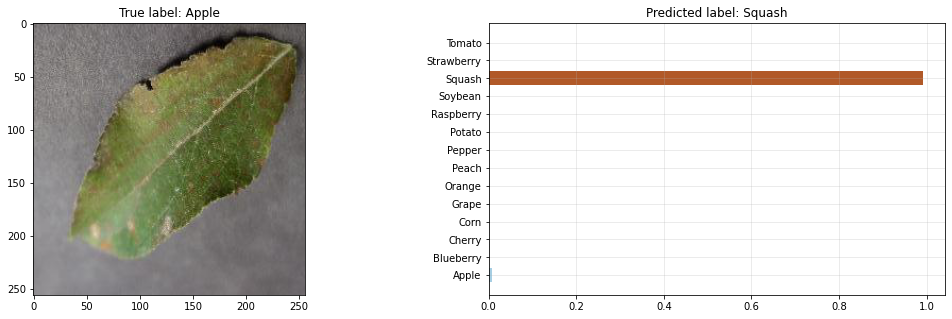

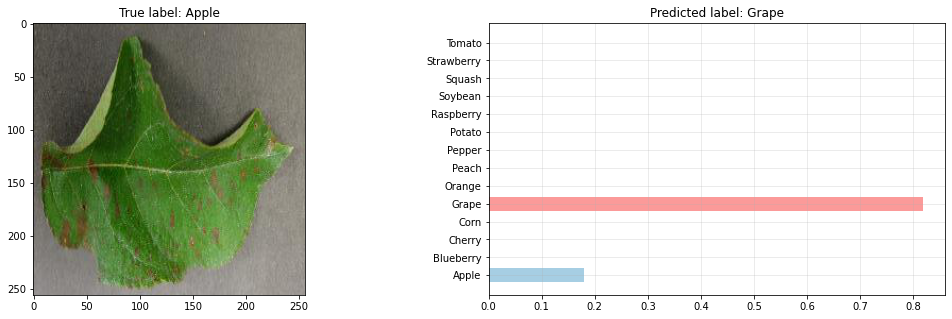

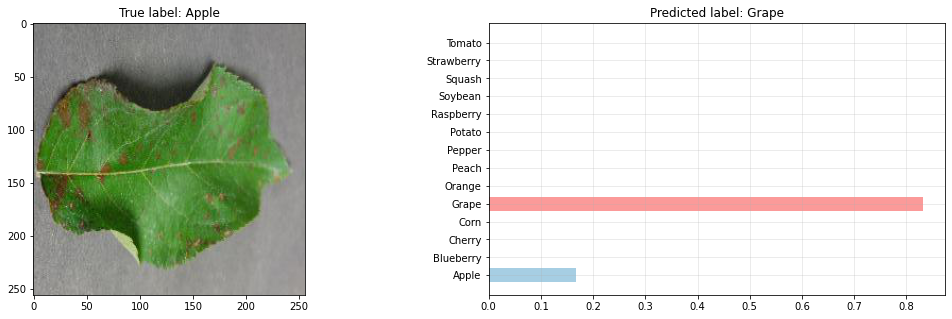

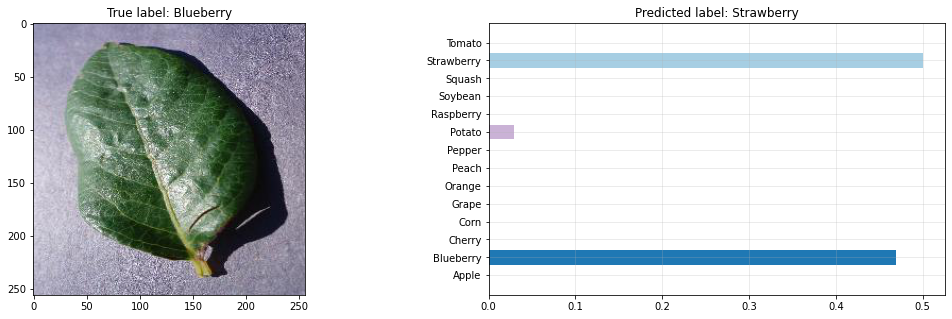

...

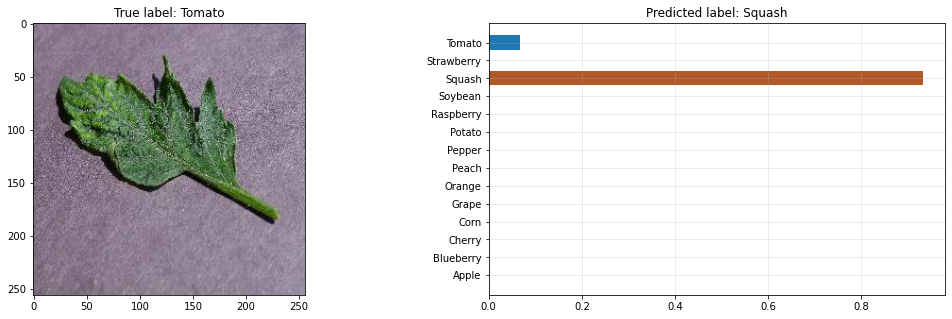

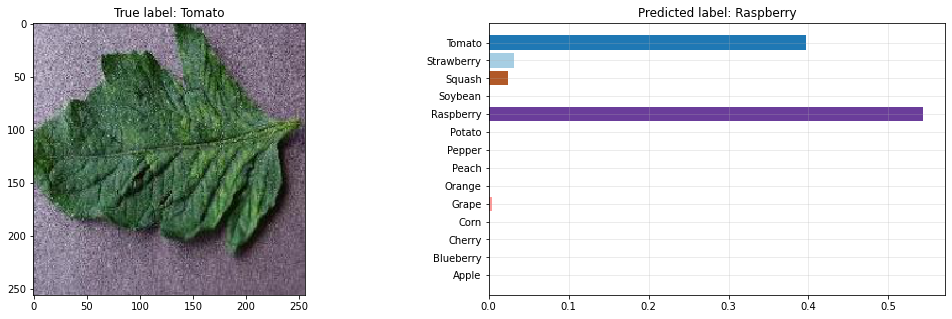

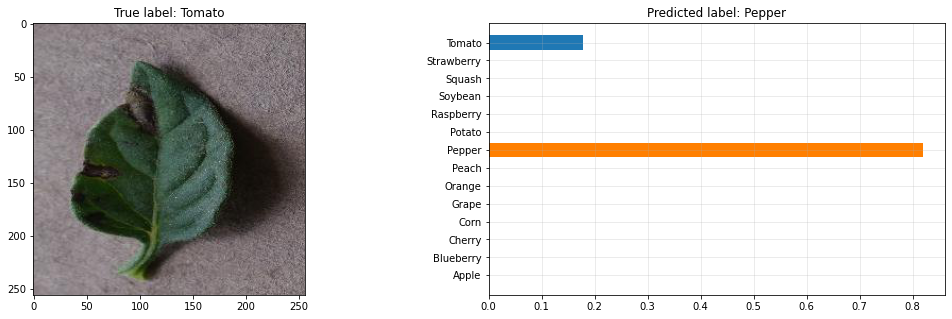

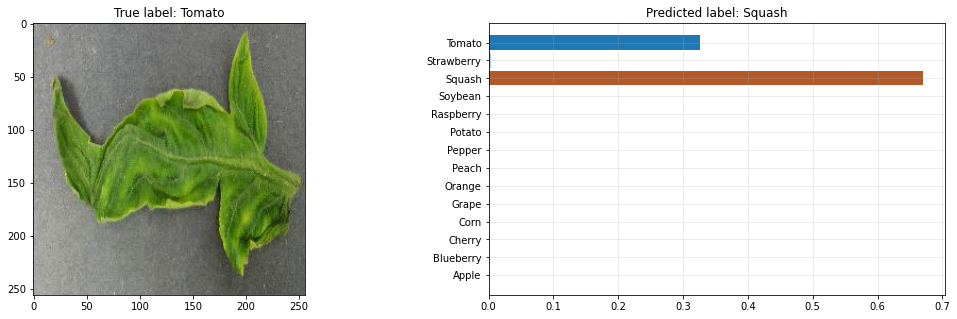

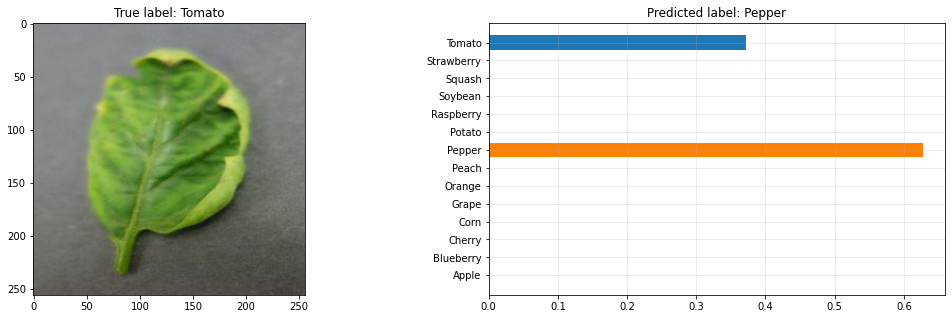

In [ ]:
def print_perc(img, true_class, pred_cl, predictions):
  fig, (ax1, ax2) = plt.subplots(1,2)
  fig.set_size_inches(18,5)
  ax1.imshow(np.uint8(img))
  ax1.set_title('True label: '+labels[true_class])
  ax2.barh(list(labels), predictions, color=plt.get_cmap('Paired').colors)
  ax2.set_title('Predicted label: '+labels[pred_cl])
  ax2.grid(alpha=.3)
  plt.show(block=True)

j = 0
for i in range(len(y_pred)):
  if test_gen.classes[i] != y_pred[i]:
    k = int(i/14)
    n = int(i%14)
    img = test_gen[k][0][n]
    # print_miss(img, test_gen.classes[i], y_pred[i])
    print_perc(img, test_gen.classes[i], y_pred[i], Y_pred[i])
    j += 1

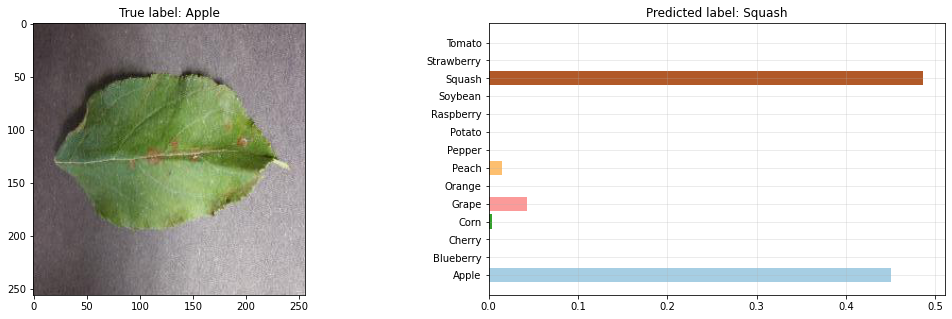

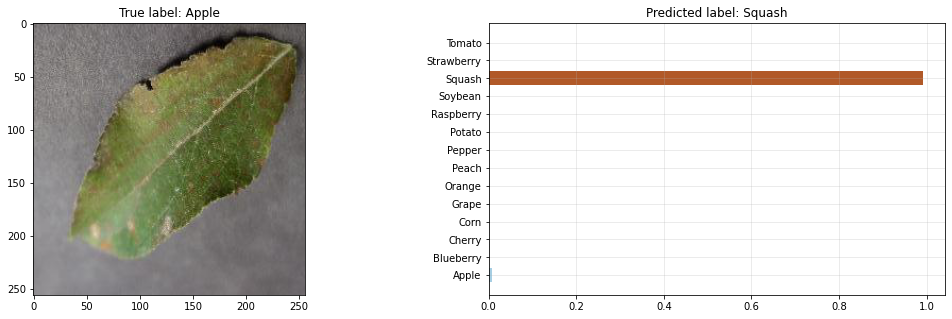

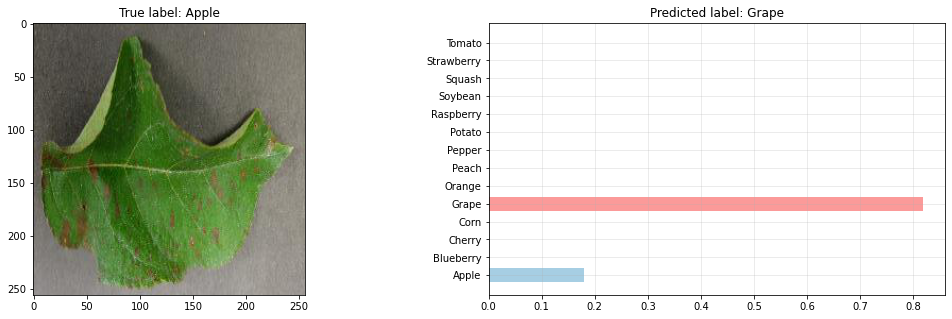

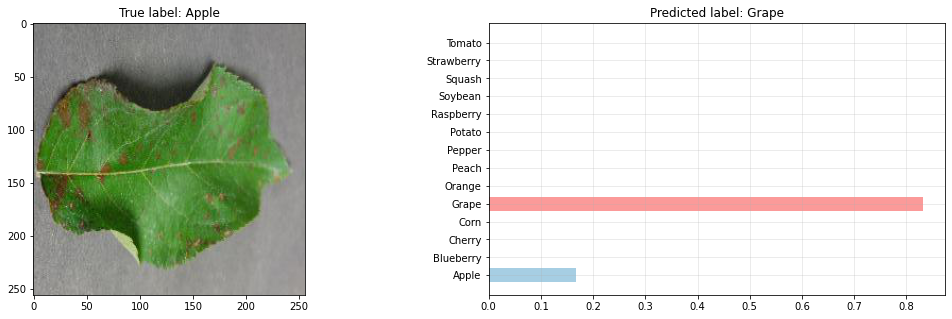

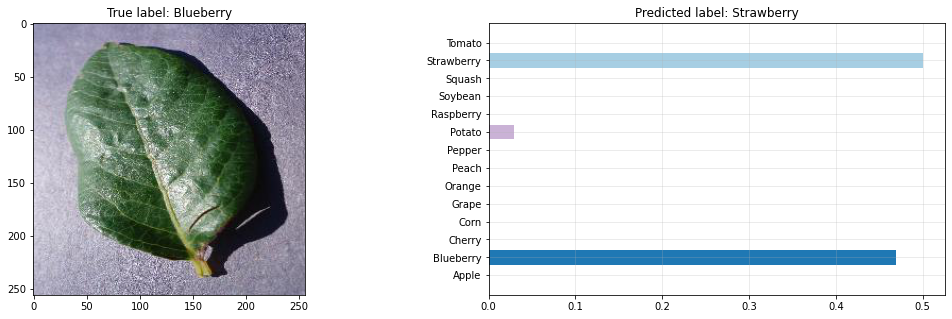

...

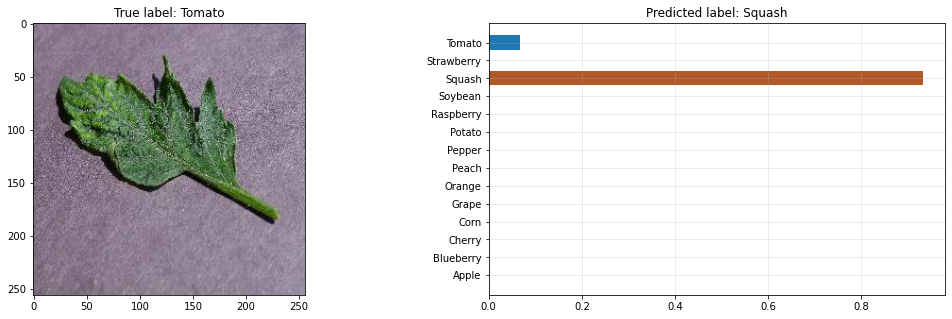

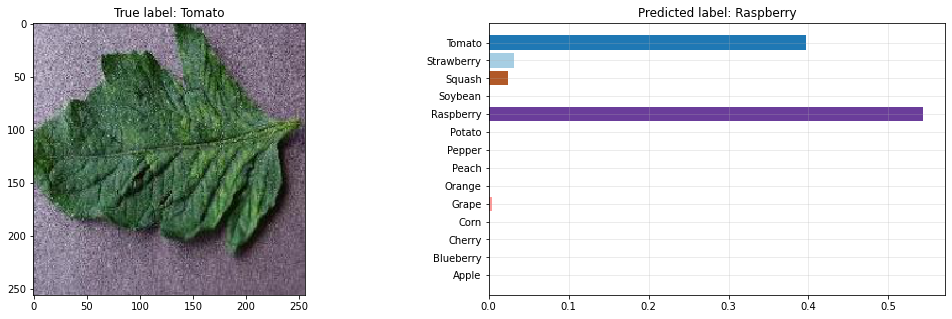

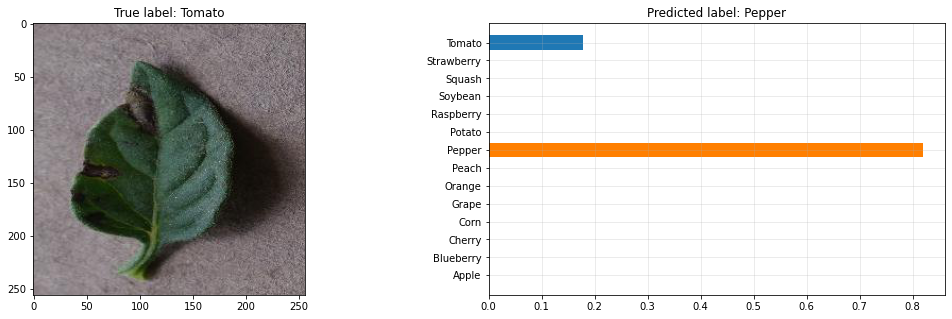

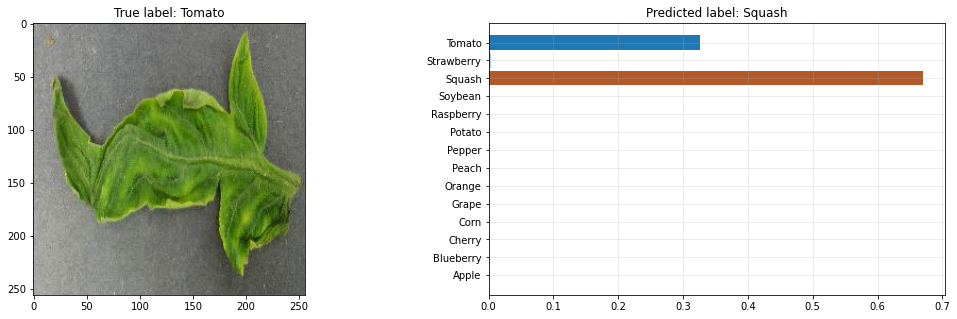

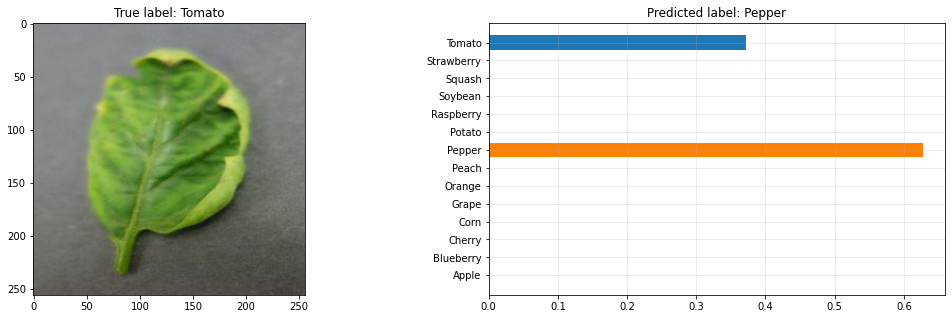

In [ ]:
j = 0
for i in range(14000):
  k = int(i/14)
  n = int(i%14)
  img = test_gen[k][0][n]
  img = tf.expand_dims(img, axis=0)
  pred = model.predict(img)
  pred_max = tf.argmax(pred, axis=1)
  if test_gen.classes[i] != pred_max:
    
    # print_miss(img, test_gen.classes[i], y_pred[i])
    img = np.squeeze(img, axis=0)
    print_perc(img, test_gen.classes[i], pred_max[0], pred[0])
    j += 1

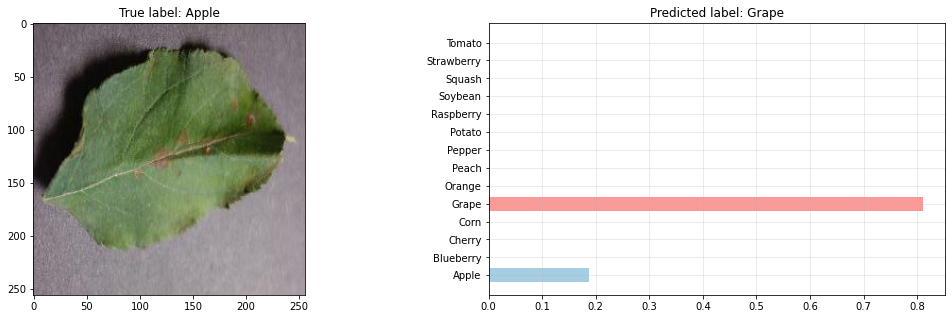

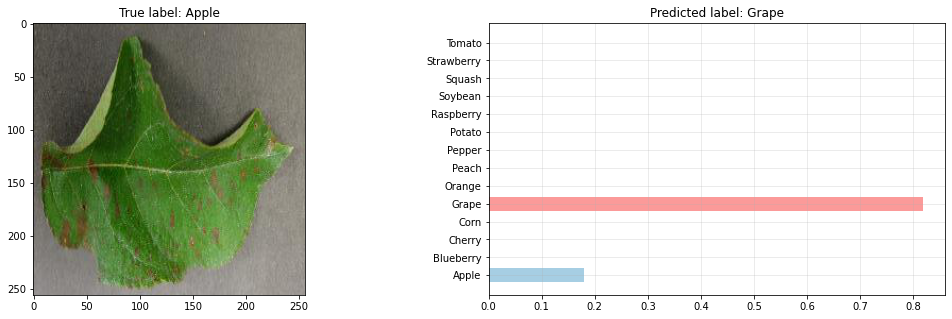

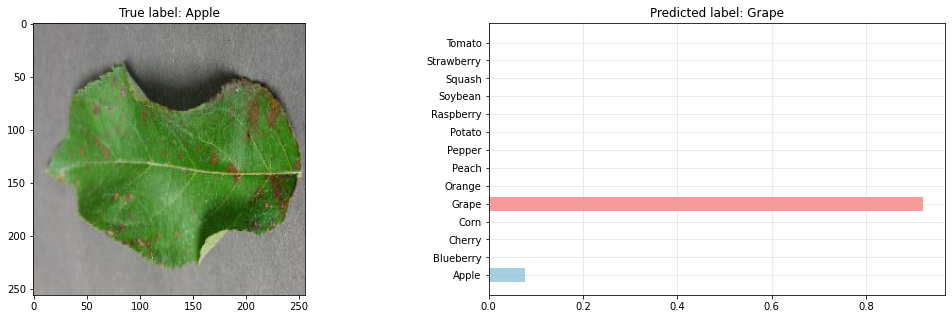

In [ ]:
j = 0
for i in range(1000):
  k = int(i/14)
  n = int(i%14)
  img = test_gen[k][0][n]
  img = tf.expand_dims(img, axis=0)
  pred = model.predict(img)
  pred_max = tf.argmax(pred, axis=1)
  if test_gen.classes[i] != pred_max:
    
    # print_miss(img, test_gen.classes[i], y_pred[i])
    img = np.squeeze(img, axis=0)
    print_perc(img, test_gen.classes[i], pred_max[0], pred[0])
    j += 1

In [ ]:
seed = 57
tf.random.set_seed(seed)

## Test Time augmentation

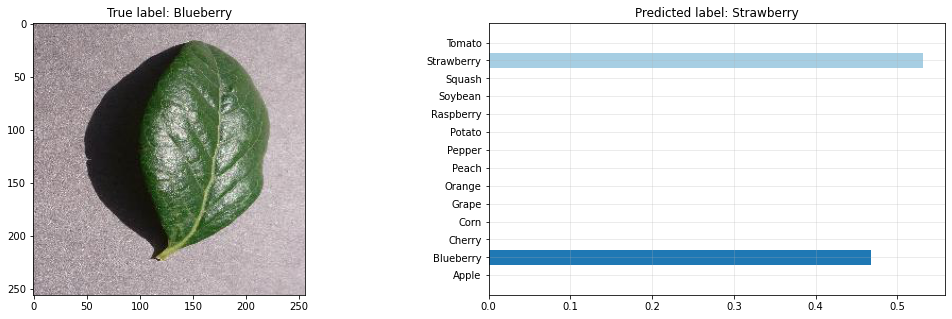

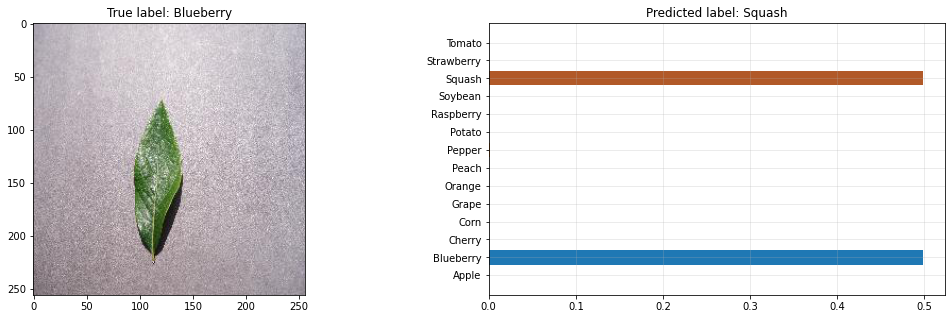

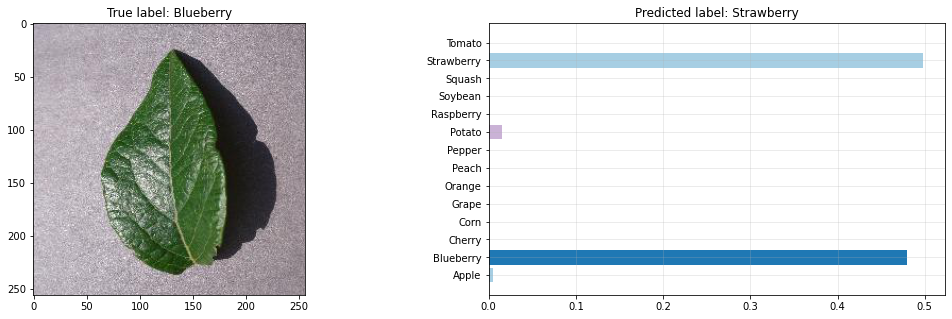

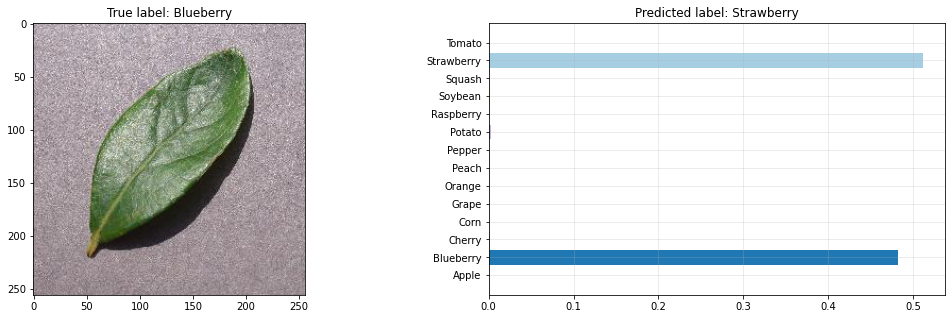

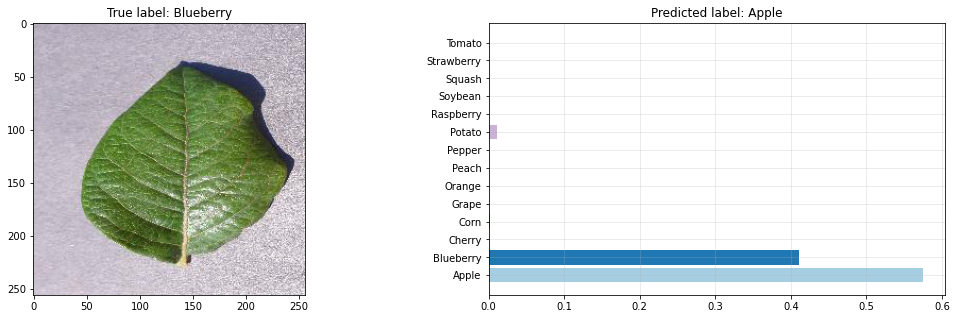

...

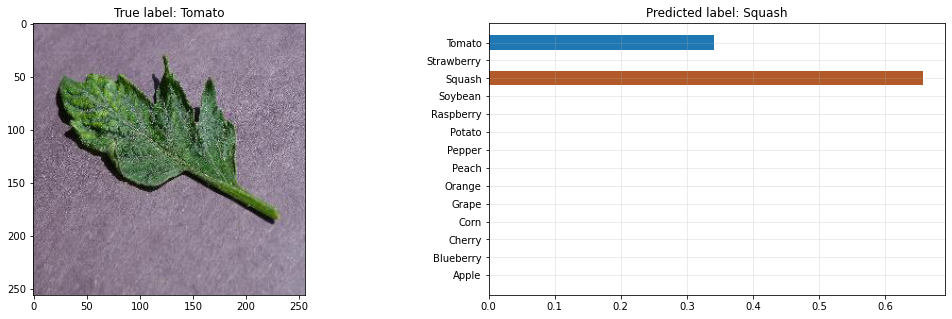

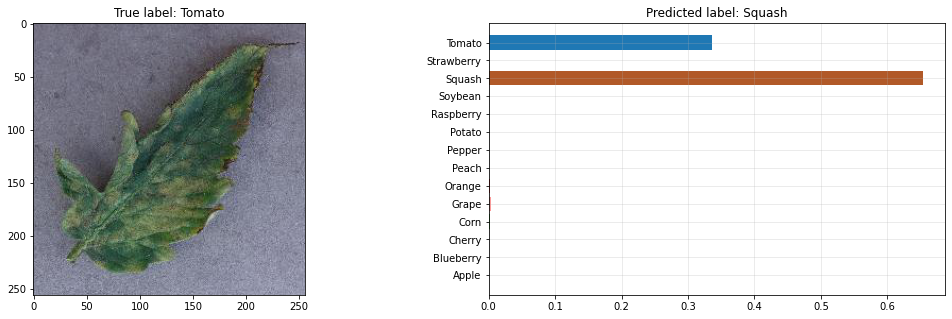

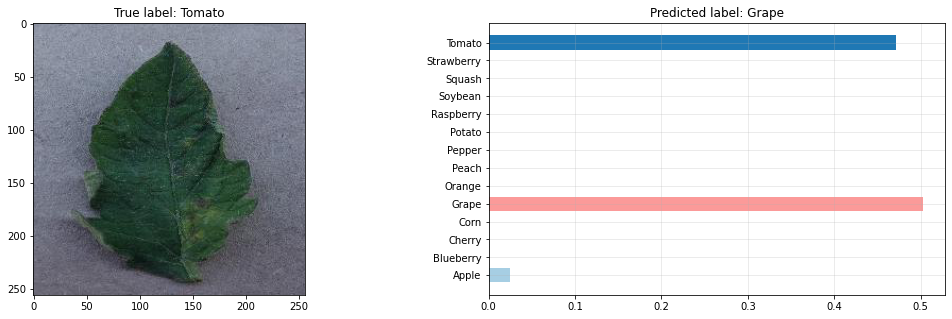

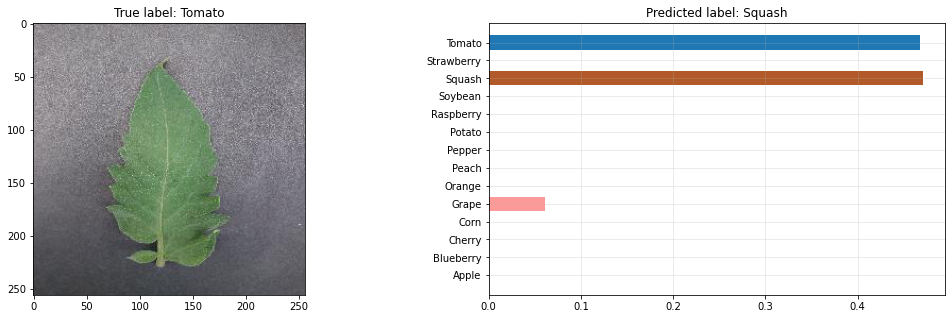

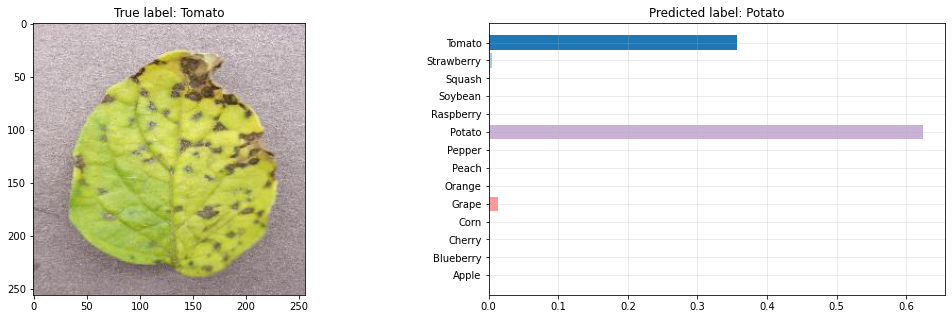

In [ ]:
j = 0
for i in range(14000):
  k = int(i/14)
  n = int(i%14)
  img = test_gen[k][0][n]
  orig = img.copy()
  
    
  outcomes = []
  for j in range(4):
    X = orig.copy() 
    X = np.rot90(X,j)
    # X = X[0]
    # Insert your preprocessing here
    # X = tf.keras.preprocessing.image.random_shift(X,1,1)

    X = tf.expand_dims(X, axis=0)
    pred = model.predict(X)
    outcomes.append(pred)

  out_avg = np.mean(np.array(outcomes), axis=0)
  pred_max = tf.argmax(out_avg, axis=1)
  if test_gen.classes[i] != pred_max:
    
    # print_miss(img, test_gen.classes[i], y_pred[i])
    # img = np.squeeze(img, axis=0)
    print_perc(img, test_gen.classes[i], pred_max[0], out_avg[0])
    j += 1

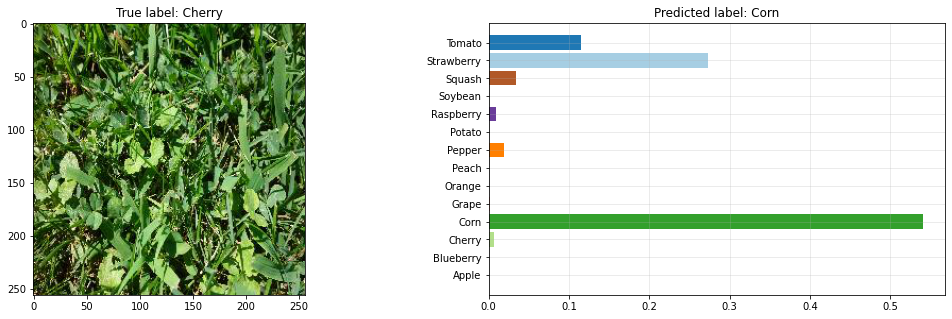

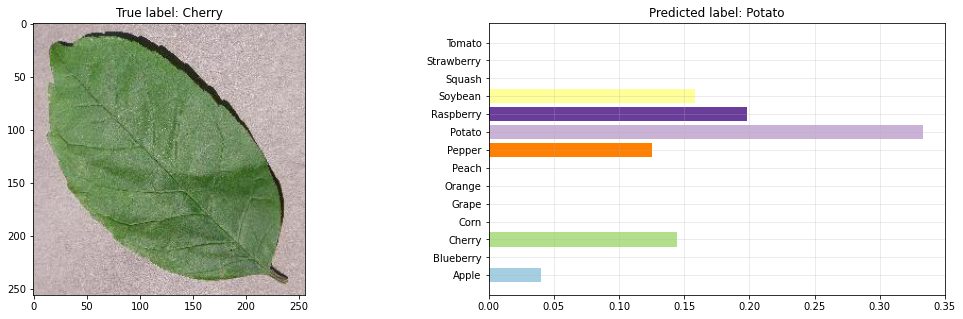

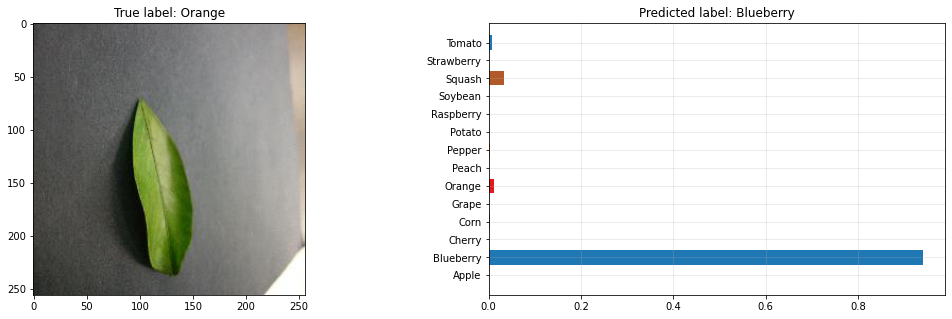

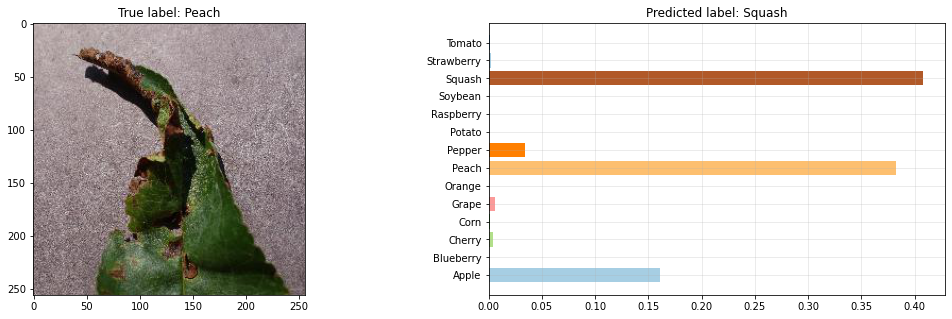

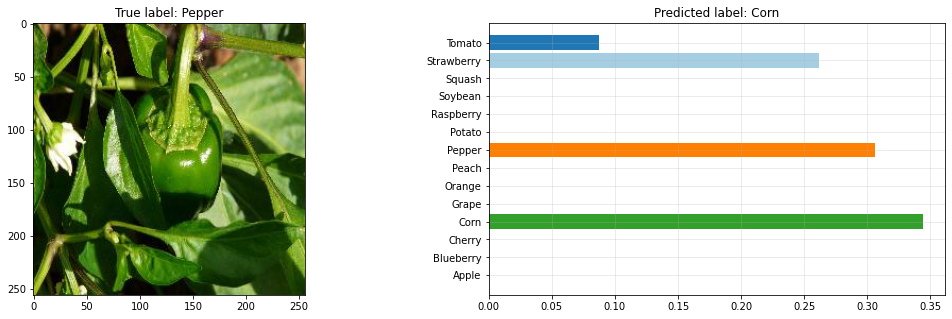

...

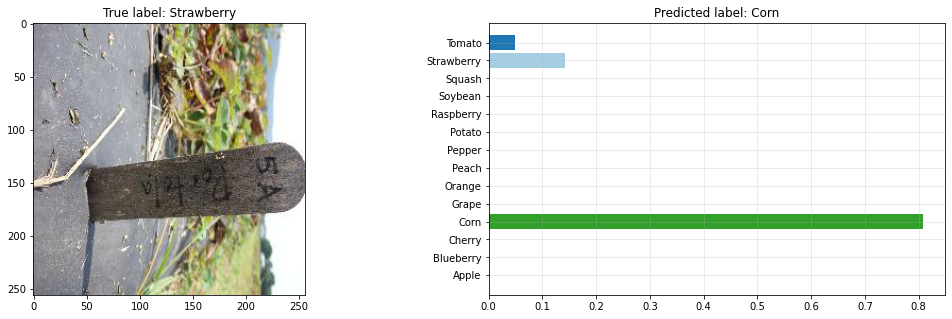

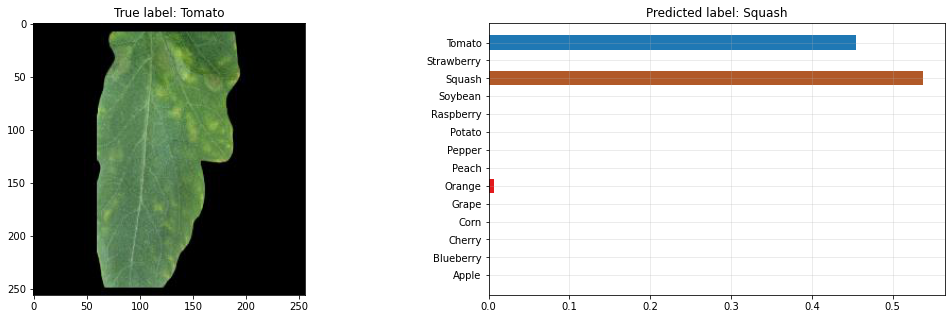

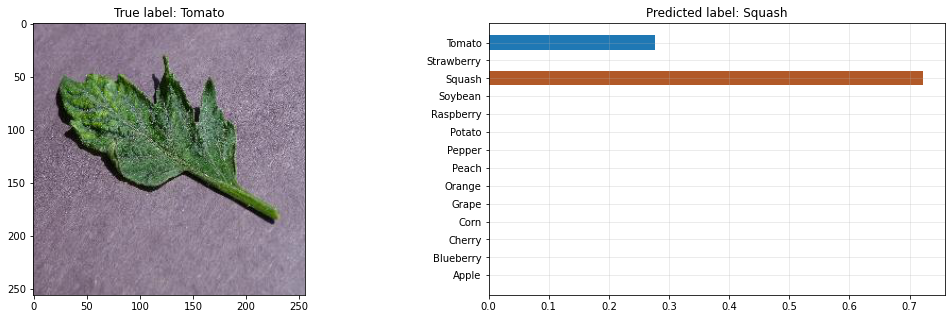

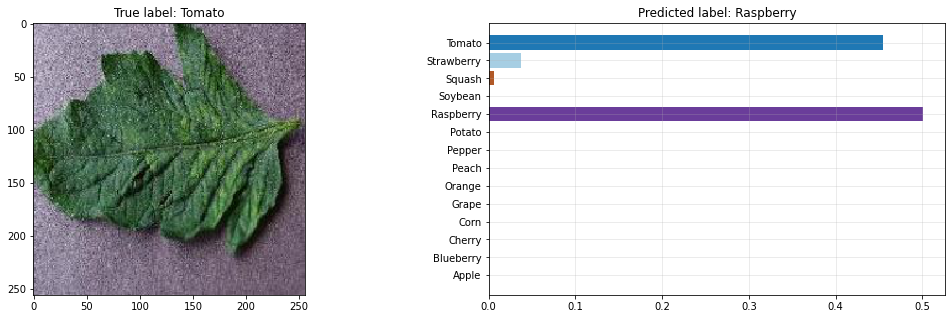

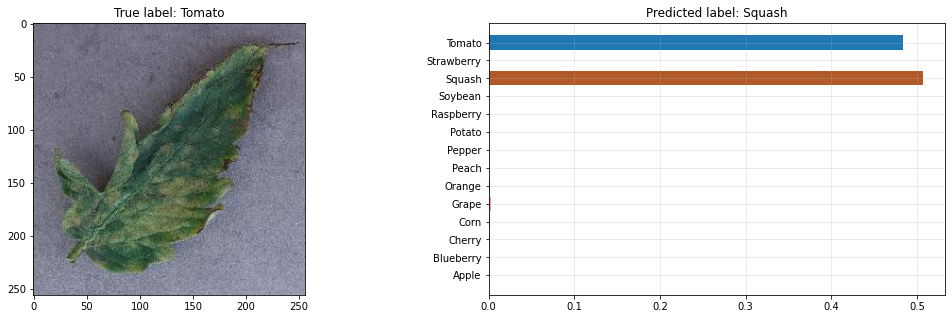

KeyboardInterrupt: ignored

In [ ]:
j = 0
for i in range(14000):
  k = int(i/14)
  n = int(i%14)
  img = test_gen[k][0][n]
  orig = img.copy()
  
    
  outcomes = []
  for j in range(4):
    X = orig.copy() 
    X = np.rot90(X,j)
    # X = X[0]
    # Insert your preprocessing here
    # X = tf.keras.preprocessing.image.random_shift(X,1,1)

    X = tf.expand_dims(X, axis=0)
    pred = model.predict(X)
    outcomes.append(pred)

  for j in range(2):
    X = orig.copy() 
    if j == 0:
      X = np.flipud(X)
    if j == 1:
      X = np.fliplr(X)
    # X = X[0]
    # Insert your preprocessing here
    # X = tf.keras.preprocessing.image.random_shift(X,1,1)

    X = tf.expand_dims(X, axis=0)
    pred = model.predict(X)
    outcomes.append(pred)

  out_avg = np.mean(np.array(outcomes), axis=0)
  pred_max = tf.argmax(out_avg, axis=1)
  if test_gen.classes[i] != pred_max:
    
    # print_miss(img, test_gen.classes[i], y_pred[i])
    # img = np.squeeze(img, axis=0)
    print_perc(img, test_gen.classes[i], pred_max[0], out_avg[0])
    j += 1